### Project Description: Zomato Data Scraping and Restaurant Insights Analysis

In this project, I scraped restaurant data from the Zomato website using Python tools like **BeautifulSoup**, **Requests**, and **Selenium**. My primary goal was to extract meaningful insights to help guide decisions for starting a new restaurant — specifically, identifying the best locations and types of cuisines that are popular in different areas.

To achieve this, I scraped data from 10 different webpages on Zomato. Each webpage contained listings of restaurants from specific locations, and I used these pages to gather a broad view of the restaurant landscape across various areas. I stored the data from each webpage in separate data frames and then combined them into a single dataset, which I saved as a **CSV file** named **'zomato_test_2.csv'**.

While scraping, I faced challenges such as handling duplicate entries and long scraping times. By focusing on 10 individual pages rather than a single large page, I was able to reduce some of these issues. After gathering the data, I performed **Exploratory Data Analysis (EDA)** to uncover insights about restaurant ratings, popular cuisines, locations, and other trends.

### Project Objective:
The main motive behind this project was to analyze the scraped data and find trends that could help in recommending the best **locations** and **cuisines** for opening a new restaurant. By looking at factors such as cuisine popularity, restaurant density, and customer ratings across different areas, I aimed to identify potential opportunities for new restaurant ventures.

Ultimately, the project is geared toward helping aspiring restaurateurs make data-driven decisions when choosing where and what kind of restaurant to open.

# Import the required Libraries

In [152]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import re
import numpy as np
import selenium
from selenium import webdriver

In [ ]:
url_="https://www.zomato.com/hyderabad/kukatpally-restaurants"

In [62]:
driver = webdriver.Chrome()
driver.get(url_)

In [63]:
page =requests.get(url_,headers = {'User-Agent':'Mozilla/5.0'})
page

<Response [200]>

<html data-rh="lang" lang="en-in"><head>
<meta content="width=device-width, initial-scale=1" name="viewport"/>
<link href="https://googleads.g.doubleclick.net" rel="preconnect"/>
<link href="https://jumbo.zomato.com" rel="preconnect"/>
<link href="https://accounts.google.com" rel="preconnect"/>
<link href="https://securepubads.g.doubleclick.net" rel="preconnect"/>
<link href="https://www.google-analytics.com" rel="preconnect"/>
<link href="https://www.googleadservices.com" rel="preconnect"/>
<link href="https://bat.bing.com" rel="preconnect"/>
<link href="https://8391443.fls.doubleclick.net" rel="preconnect"/>
<title>Restaurants in Kukatpally - Zomato</title>
<meta charset="utf-8" data-rh="true"/><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-6HC28B0H9G&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-X6B66E85ZJ&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://
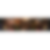
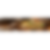
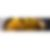
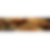
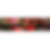
...
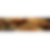
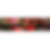
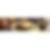
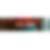
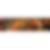

In [64]:
soup = BeautifulSoup(driver.page_source, "html.parser")
soup

In [65]:
links=[]
for i in soup.find_all('a'):
    if i.has_attr('href'):
        a= re.findall("^.*info$",i['href'])
        if len(a)==1:
            links.append(a[0])
links

['/hyderabad/firestone-grill-kukatpally/info',
 '/hyderabad/firestone-grill-kukatpally/info',
 '/hyderabad/barkaas-indo-arabic-restaurant-kukatpally/info',
 '/hyderabad/barkaas-indo-arabic-restaurant-kukatpally/info',
 '/hyderabad/tabla-kukatpally/info',
 '/hyderabad/tabla-kukatpally/info',
 '/hyderabad/chowman-kukatpally/info',
 '/hyderabad/chowman-kukatpally/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/komma-the-club-kothaguda/info',
 '/hyderabad/komma-the-club-kothaguda/info',
 '/hyderabad/barbeque-holic-kondapur/info',
 '/hyderabad/barbeque-holic-kondapur/info',
 '/hyderabad/krishnapatnam-kukatpally/info',
 '/hyderabad/krishnapatnam-kukatpally/info',
 '/hyderabad/7-sisters-kondapur/info',
 '/hyderabad/7-sisters-kondapur/info',
 '/hyderabad/renao-cafe-bistro-madhapur/info',
 '/hyderabad/renao-cafe-bistro-madhapur/info',
 '/hyderabad/the-grand-trunk-road-madhapur/info',
 '/hyderabad/the-grand-trunk-road-madhapur/info',
 '/hyderab

In [66]:
links[::2]

['/hyderabad/firestone-grill-kukatpally/info',
 '/hyderabad/barkaas-indo-arabic-restaurant-kukatpally/info',
 '/hyderabad/tabla-kukatpally/info',
 '/hyderabad/chowman-kukatpally/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/komma-the-club-kothaguda/info',
 '/hyderabad/barbeque-holic-kondapur/info',
 '/hyderabad/krishnapatnam-kukatpally/info',
 '/hyderabad/7-sisters-kondapur/info',
 '/hyderabad/renao-cafe-bistro-madhapur/info',
 '/hyderabad/the-grand-trunk-road-madhapur/info',
 '/hyderabad/sadda-punjabi-cafe-madhapur/info',
 '/hyderabad/trops-kitchen-tavern-madhapur/info',
 '/hyderabad/ouvra-telugu-kitchen-madhapur/info',
 '/hyderabad/tgi-fridays-kukatpally/info',
 '/hyderabad/barbeque-nation-kukatpally/info',
 '/hyderabad/the-big-cup-theory-2-madhapur/info',
 '/hyderabad/california-burrito-moosapet/info',
 '/hyderabad/wow-momo-1-moosapet/info',
 '/hyderabad/manchi-baphe-kondapur/info',
 '/hyderabad/nidhivan-moosapet/info',
 '/hyderabad/ironhill-kukatpally/info',
 '/hydera

In [67]:
len(links[::2])

501

In [68]:
x = []
for i in links[::2]:
    x.append('https://www.zomato.com'+i)
x

['https://www.zomato.com/hyderabad/firestone-grill-kukatpally/info',
 'https://www.zomato.com/hyderabad/barkaas-indo-arabic-restaurant-kukatpally/info',
 'https://www.zomato.com/hyderabad/tabla-kukatpally/info',
 'https://www.zomato.com/hyderabad/chowman-kukatpally/info',
 'https://www.zomato.com/hyderabad/exotica-hitech-city/info',
 'https://www.zomato.com/hyderabad/komma-the-club-kothaguda/info',
 'https://www.zomato.com/hyderabad/barbeque-holic-kondapur/info',
 'https://www.zomato.com/hyderabad/krishnapatnam-kukatpally/info',
 'https://www.zomato.com/hyderabad/7-sisters-kondapur/info',
 'https://www.zomato.com/hyderabad/renao-cafe-bistro-madhapur/info',
 'https://www.zomato.com/hyderabad/the-grand-trunk-road-madhapur/info',
 'https://www.zomato.com/hyderabad/sadda-punjabi-cafe-madhapur/info',
 'https://www.zomato.com/hyderabad/trops-kitchen-tavern-madhapur/info',
 'https://www.zomato.com/hyderabad/ouvra-telugu-kitchen-madhapur/info',
 'https://www.zomato.com/hyderabad/tgi-fridays-ku

In [69]:
name = []
cuisine = []
location = []
dining_rating = []
price = []
Takeaway = []
h_delivery = []
delivery_rating = []

for i in x:
    driver = webdriver.Chrome()
    driver.get(i)
    soup = BeautifulSoup(driver.page_source, "html.parser")
    content = soup.find_all('div', class_="sc-fEUNkw gAkuDn")
    
    for i in content:
        
        a = i.find("h1", class_="sc-7kepeu-0 sc-iSDuPN fwzNdh")
        if a:
            name.append(a.text)
        else:
            name.append(np.nan)
        
        b = i.find("div", class_="sc-fgfRvd gBMRZZ")
        if b:
            cuisine.append(b.text)
        else:
            cuisine.append(np.nan)
            
        c = i.find("a", class_="sc-clNaTc vNCcy")
        if c:
            location.append(c.text)
        else:
            location.append(np.nan)
        
        d = i.find("div", class_="sc-1q7bklc-1 cILgox")
        if d:
            dining_rating.append(d.text)
        else:
            dining_rating.append(np.nan)
        
        e = re.findall('₹(.*)\sfor\stwo\speople',i.text)
        if e:
            price.append(e[0])
        else:
            price.append(np.nan)
        
        f = re.findall('Takeaway\sAvailable',i.text)
        if f:
            Takeaway.append("Yes")
        else:
            Takeaway.append('No')
        
        g = re.findall('Home\sDelivery',i.text)
        if g:
            h_delivery.append("Yes")
        else:
            h_delivery.append('No')
            
        h = re.findall('Ratings(\d\.\d)star',i.text)
        if h:
            delivery_rating.append(h[0])
        else:
            delivery_rating.append(np.nan)

driver.quit()

In [19]:
df1 = pd.DataFrame({'Name' :  name, 
                'Cuisines':cuisine, 
                'Location':location, 
                'Dining_rating' :dining_rating,
                 'Price'  :price, 
                'Takeaway':Takeaway,
                'Home_Delivery':h_delivery,
                  'Delivery_rating':delivery_rating})
df1

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,NaN,NaN,NaN,NaN,NaN,No,No,NaN
1,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts","Kukatpally, Hyderabad",4.4,"1,300",Yes,Yes,3.9
2,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...","Kukatpally, Hyderabad",3.6,"1,250",Yes,Yes,4.2
3,Chowman,"Chinese, Thai, Asian, Seafood, Sichuan, Desser...","Kukatpally, Hyderabad",4.4,"1,400",Yes,Yes,4.2
4,Barbeque Holic,"Chinese, Salad, Fast Food, North Indian, Desse...","Kondapur, Hyderabad",4.5,"1,500",Yes,Yes,4.3
...,...,...,...,...,...,...,...,...
481,Cocotang,"Beverages, Shake, Street Food","Nizampet, Hyderabad",3.4,300,Yes,Yes,4.2
482,Cake Buzz Bakers,"Bakery, Fast Food, Chinese","Kukatpally, Hyderabad",3.9,300,Yes,Yes,NaN
483,Baleundi,"South Indian, Biryani, Chinese, North Indian, ...","Moosapet, Hyderabad",3.8,400,Yes,Yes,3.5
484,Aira's Cafe,"Fast Food, Beverages","Kukatpally, Hyderabad",3.9,400,Yes,Yes,NaN


In [70]:
url_="https://www.zomato.com/hyderabad/jubilee-hills-restaurants"

In [71]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import re
import numpy as np
import selenium
from selenium import webdriver

In [72]:
driver = webdriver.Chrome()
driver.get(url_)

In [73]:
page =requests.get(url_,headers = {'User-Agent':'Mozilla/5.0'})
page

<Response [200]>

<html data-rh="lang" lang="en-in"><head>
<meta content="width=device-width, initial-scale=1" name="viewport"/>
<link href="https://googleads.g.doubleclick.net" rel="preconnect"/>
<link href="https://jumbo.zomato.com" rel="preconnect"/>
<link href="https://accounts.google.com" rel="preconnect"/>
<link href="https://securepubads.g.doubleclick.net" rel="preconnect"/>
<link href="https://www.google-analytics.com" rel="preconnect"/>
<link href="https://www.googleadservices.com" rel="preconnect"/>
<link href="https://bat.bing.com" rel="preconnect"/>
<link href="https://8391443.fls.doubleclick.net" rel="preconnect"/>
<title>Restaurants in Jubilee Hills - Zomato</title>
<meta charset="utf-8" data-rh="true"/><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-2XVFHLPTVP&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-X6B66E85ZJ&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https
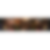
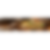
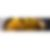
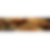
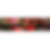
...
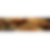
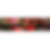
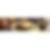
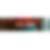
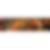

In [74]:
soup = BeautifulSoup(driver.page_source, "html.parser")
soup

In [75]:
links=[]
for i in soup.find_all('a'):
    if i.has_attr('href'):
        a= re.findall("^.*info$",i['href'])
        if len(a)==1:
            links.append(a[0])
links

['/hyderabad/the-glass-house-jubilee-hills/info',
 '/hyderabad/the-glass-house-jubilee-hills/info',
 '/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 '/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 '/hyderabad/erra-karam-south-indian-resto-bar-jubilee-hills/info',
 '/hyderabad/erra-karam-south-indian-resto-bar-jubilee-hills/info',
 '/hyderabad/bel-posto-the-cafe-1-jubilee-hills/info',
 '/hyderabad/bel-posto-the-cafe-1-jubilee-hills/info',
 '/hyderabad/kavyam-the-telugu-table-jubilee-hills/info',
 '/hyderabad/kavyam-the-telugu-table-jubilee-hills/info',
 '/hyderabad/antera-kitchen-and-bar-jubilee-hills/info',
 '/hyderabad/antera-kitchen-and-bar-jubilee-hills/info',
 '/hyderabad/lord-of-the-drinks-jubilee-hills/info',
 '/hyderabad/lord-of-the-drinks-jubilee-hills/info',
 '/hyderabad/navika-cafe-film-nagar/info',
 '/hyderabad/navika-cafe-film-nagar/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibow

In [76]:
links[::2]

['/hyderabad/the-glass-house-jubilee-hills/info',
 '/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 '/hyderabad/erra-karam-south-indian-resto-bar-jubilee-hills/info',
 '/hyderabad/bel-posto-the-cafe-1-jubilee-hills/info',
 '/hyderabad/kavyam-the-telugu-table-jubilee-hills/info',
 '/hyderabad/antera-kitchen-and-bar-jubilee-hills/info',
 '/hyderabad/lord-of-the-drinks-jubilee-hills/info',
 '/hyderabad/navika-cafe-film-nagar/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/lé-vantage-cafe-bar-jubilee-hills/info',
 '/hyderabad/kortyard-cafe-jubilee-hills/info',
 '/hyderabad/makau-jubilee-hills/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/babylon-bar-and-kitchen-jubilee-hills/info',
 '/hyderabad/air-live-jubilee-hills/info',
 '/hyderabad/krishnapatnam-jubilee-hills/info',
 '/hyderabad/sakura-a-far-eastern-kitchen-1-jubilee-hills/info',
 '/hyderabad/naatu-kitchen-and-bar-jubilee-hills/info',
 '/hyderabad/fly-feel-the-

In [77]:
len(links[::2])

501

In [78]:
x = []
for i in links[::2]:
    x.append('https://www.zomato.com'+i)
x

['https://www.zomato.com/hyderabad/the-glass-house-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/erra-karam-south-indian-resto-bar-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/bel-posto-the-cafe-1-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/kavyam-the-telugu-table-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/antera-kitchen-and-bar-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/lord-of-the-drinks-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/navika-cafe-film-nagar/info',
 'https://www.zomato.com/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 'https://www.zomato.com/hyderabad/lé-vantage-cafe-bar-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/kortyard-cafe-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/makau-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 'https://

In [79]:
name = []
cuisine = []
location = []
dining_rating = []
price = []
Takeaway = []
h_delivery = []
delivery_rating = []

for i in x:
    driver = webdriver.Chrome()
    driver.get(i)
    soup = BeautifulSoup(driver.page_source, "html.parser")
    content = soup.find_all('div', class_="sc-fEUNkw gAkuDn")
    
    for i in content:
        
        a = i.find("h1", class_="sc-7kepeu-0 sc-iSDuPN fwzNdh")
        if a:
            name.append(a.text)
        else:
            name.append(np.nan)
        
        b = i.find("div", class_="sc-fgfRvd gBMRZZ")
        if b:
            cuisine.append(b.text)
        else:
            cuisine.append(np.nan)
            
        c = i.find("a", class_="sc-clNaTc vNCcy")
        if c:
            location.append(c.text)
        else:
            location.append(np.nan)
        
        d = i.find("div", class_="sc-1q7bklc-1 cILgox")
        if d:
            dining_rating.append(d.text)
        else:
            dining_rating.append(np.nan)
        
        e = re.findall('₹(.*)\sfor\stwo\speople',i.text)
        if e:
            price.append(e[0])
        else:
            price.append(np.nan)
        
        f = re.findall('Takeaway\sAvailable',i.text)
        if f:
            Takeaway.append("Yes")
        else:
            Takeaway.append('No')
        
        g = re.findall('Home\sDelivery',i.text)
        if g:
            h_delivery.append("Yes")
        else:
            h_delivery.append('No')
            
        h = re.findall('Ratings(\d\.\d)star',i.text)
        if h:
            delivery_rating.append(h[0])
        else:
            delivery_rating.append(np.nan)

driver.quit()

In [80]:
df2 = pd.DataFrame({'Name' :  name, 
                'Cuisines':cuisine, 
                'Location':location, 
                'Dining_rating' :dining_rating,
                 'Price'  :price, 
                'Takeaway':Takeaway,
                'Home_Delivery':h_delivery,
                  'Delivery_rating':delivery_rating})
df2

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,The Glass House,"Modern Indian, Cafe, Asian, Coffee, Desserts, ...","Jubilee Hills, Hyderabad",4.3,"2,000",Yes,Yes,4.0
1,Nataka Global Kitchen And Cafe,"Continental, Asian, Thai, Andhra, Italian, Chi...","Jubilee Hills, Hyderabad",4.3,"1,500",Yes,Yes,4.3
2,Erra Karam - South Indian Resto Bar,"Andhra, Chinese, Kebab, North Indian, South In...","Jubilee Hills, Hyderabad",4.3,"1,400",Yes,Yes,4.3
3,Bel Posto The Cafe,"Cafe, Salad, Healthy Food, Continental, Fast F...","Jubilee Hills, Hyderabad",4.1,950,Yes,Yes,4.1
4,Kavyam The Telugu Table,"South Indian, North Indian, Biryani, Chinese, ...","Jubilee Hills, Hyderabad",4.3,"1,500",Yes,No,3.7
...,...,...,...,...,...,...,...,...
469,Kembara,Asian,"Madhapur, Hyderabad",New,"2,000",No,No,NaN
470,Harley's Fine Baking,Desserts,"Manikonda, Hyderabad",3.8,600,Yes,Yes,4.5
471,Naidu Gari Kunda Biryani,"South Indian, Chinese","S R Nagar, Hyderabad",4.1,700,Yes,Yes,4.1
472,UR Life Cafe,"Cafe, Beverages, Healthy Food, Italian, Wraps,...","Jubilee Hills, Hyderabad",3.8,"1,600",Yes,Yes,4.1


In [81]:
url_="https://www.zomato.com/hyderabad/gachibowli-restaurants"

In [82]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import re
import numpy as np
import selenium
from selenium import webdriver

In [83]:
driver = webdriver.Chrome()
driver.get(url_)

In [84]:
page =requests.get(url_,headers = {'User-Agent':'Mozilla/5.0'})
page

<Response [200]>

<html data-rh="lang" lang="en-in"><head>
<meta content="width=device-width, initial-scale=1" name="viewport"/>
<link href="https://googleads.g.doubleclick.net" rel="preconnect"/>
<link href="https://jumbo.zomato.com" rel="preconnect"/>
<link href="https://accounts.google.com" rel="preconnect"/>
<link href="https://securepubads.g.doubleclick.net" rel="preconnect"/>
<link href="https://www.google-analytics.com" rel="preconnect"/>
<link href="https://www.googleadservices.com" rel="preconnect"/>
<link href="https://bat.bing.com" rel="preconnect"/>
<link href="https://8391443.fls.doubleclick.net" rel="preconnect"/>
<title>Restaurants in Gachibowli - Zomato</title>
<meta charset="utf-8" data-rh="true"/><script async="" src="https://connect.facebook.net/signals/config/1466145233705476?v=2.9.148&amp;r=stable&amp;domain=www.zomato.com&amp;hme=20c913bdcd4be51a752120153aa5caaecb3ee86c7f26cf737846e40b202aba68&amp;ex_m=62%2C106%2C94%2C98%2C53%2C3%2C88%2C61%2C14%2C86%2C79%2C44%2C46%2C150%2C153%2C164
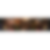
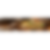
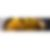
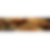
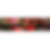
...
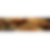
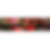
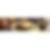
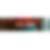
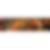

In [85]:
soup = BeautifulSoup(driver.page_source, "html.parser")
soup

In [86]:
links=[]
for i in soup.find_all('a'):
    if i.has_attr('href'):
        a= re.findall("^.*info$",i['href'])
        if len(a)==1:
            links.append(a[0])
links

['/hyderabad/over-the-moon-brew-company-gachibowli/info',
 '/hyderabad/over-the-moon-brew-company-gachibowli/info',
 '/hyderabad/tabula-rasa-gachibowli/info',
 '/hyderabad/tabula-rasa-gachibowli/info',
 '/hyderabad/cravery-cafe-financial-district/info',
 '/hyderabad/cravery-cafe-financial-district/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/mamalola-penthouse-bar-kitchen-gachibowli/info',
 '/hyderabad/mamalola-penthouse-bar-kitchen-gachibowli/info',
 '/hyderabad/haiku-gachibowli/info',
 '/hyderabad/haiku-gachibowli/info',
 '/hyderabad/cock-bull-madhapur/info',
 '/hyderabad/cock-bull-madhapur/info',
 '/hyderabad/sesame-gachibowli/info',
 '/hyderabad/sesame-gachibowli/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 '/hyderabad/tevar-the-progressive-indian-k

In [87]:
links[::2]

['/hyderabad/over-the-moon-brew-company-gachibowli/info',
 '/hyderabad/tabula-rasa-gachibowli/info',
 '/hyderabad/cravery-cafe-financial-district/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/mamalola-penthouse-bar-kitchen-gachibowli/info',
 '/hyderabad/haiku-gachibowli/info',
 '/hyderabad/cock-bull-madhapur/info',
 '/hyderabad/sesame-gachibowli/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 '/hyderabad/purple-potato-gachibowli/info',
 '/hyderabad/makau-jubilee-hills/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/antera-kitchen-and-bar-gachibowli/info',
 '/hyderabad/red-rhino-hitech-city/info',
 '/hyderabad/barbeque-holic-kondapur/info',
 '/hyderabad/luno-lounge-bar-kitchen-financial-district/info',
 '/hyderabad/air-live-gachibowli/info',
 '/hyderabad/ohris-rubaiyat-hitech-city/info',
 '/hyderabad/president-dhaba-madhapur/info',
 '/hyderabad/hard-rock-ca

In [88]:
len(links[::2])

501

In [89]:
x = []
for i in links[::2]:
    x.append('https://www.zomato.com'+i)
x

['https://www.zomato.com/hyderabad/over-the-moon-brew-company-gachibowli/info',
 'https://www.zomato.com/hyderabad/tabula-rasa-gachibowli/info',
 'https://www.zomato.com/hyderabad/cravery-cafe-financial-district/info',
 'https://www.zomato.com/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 'https://www.zomato.com/hyderabad/mamalola-penthouse-bar-kitchen-gachibowli/info',
 'https://www.zomato.com/hyderabad/haiku-gachibowli/info',
 'https://www.zomato.com/hyderabad/cock-bull-madhapur/info',
 'https://www.zomato.com/hyderabad/sesame-gachibowli/info',
 'https://www.zomato.com/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 'https://www.zomato.com/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 'https://www.zomato.com/hyderabad/purple-potato-gachibowli/info',
 'https://www.zomato.com/hyderabad/makau-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/exotica-hitech-city/info',
 'https://www.zomato.com/hyderabad/antera-kitchen-and-bar-gachibowli/info'

In [90]:
name = []
cuisine = []
location = []
dining_rating = []
price = []
Takeaway = []
h_delivery = []
delivery_rating = []

for i in x:
    driver = webdriver.Chrome()
    driver.get(i)
    soup = BeautifulSoup(driver.page_source, "html.parser")
    content = soup.find_all('div', class_="sc-fEUNkw gAkuDn")
    
    for i in content:
        
        a = i.find("h1", class_="sc-7kepeu-0 sc-iSDuPN fwzNdh")
        if a:
            name.append(a.text)
        else:
            name.append(np.nan)
        
        b = i.find("div", class_="sc-fgfRvd gBMRZZ")
        if b:
            cuisine.append(b.text)
        else:
            cuisine.append(np.nan)
            
        c = i.find("a", class_="sc-clNaTc vNCcy")
        if c:
            location.append(c.text)
        else:
            location.append(np.nan)
        
        d = i.find("div", class_="sc-1q7bklc-1 cILgox")
        if d:
            dining_rating.append(d.text)
        else:
            dining_rating.append(np.nan)
        
        e = re.findall('₹(.*)\sfor\stwo\speople',i.text)
        if e:
            price.append(e[0])
        else:
            price.append(np.nan)
        
        f = re.findall('Takeaway\sAvailable',i.text)
        if f:
            Takeaway.append("Yes")
        else:
            Takeaway.append('No')
        
        g = re.findall('Home\sDelivery',i.text)
        if g:
            h_delivery.append("Yes")
        else:
            h_delivery.append('No')
            
        h = re.findall('Ratings(\d\.\d)star',i.text)
        if h:
            delivery_rating.append(h[0])
        else:
            delivery_rating.append(np.nan)

driver.quit()

In [91]:
df3 = pd.DataFrame({'Name' :  name, 
                'Cuisines':cuisine, 
                'Location':location, 
                'Dining_rating' :dining_rating,
                 'Price'  :price, 
                'Takeaway':Takeaway,
                'Home_Delivery':h_delivery,
                  'Delivery_rating':delivery_rating})
df3

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,Over The Moon Brew Company,"Asian, Continental, North Indian, Italian, Mom...","Gachibowli, Hyderabad",4.9,"3,000",No,Yes,4.4
1,Tabula Rasa,"North Indian, South Indian, Asian, Chinese, Co...","Gachibowli, Hyderabad",4.4,"1,000",Yes,No,NaN
2,Cravery Cafe,"Cafe, Coffee, North Indian, Mughlai, Seafood, ...","Financial District, Hyderabad",New,"1,000",Yes,Yes,NaN
3,Elsewhere Lounge & Kitchen,"North Indian, Mughlai, Continental, Pizza, Pas...","Gachibowli, Hyderabad",4.2,"2,000",Yes,No,NaN
4,Mamalola Penthouse Bar & Kitchen,"Continental, Modern Indian, Asian, Pizza, Fast...","Gachibowli, Hyderabad",4.4,"1,700",Yes,No,NaN
...,...,...,...,...,...,...,...,...
475,The Halal Republic,"Arabian, Wraps, Fast Food","Madhapur, Hyderabad",3.0,500,Yes,Yes,4.1
476,NaN,NaN,NaN,NaN,NaN,No,No,NaN
477,Millet Marvels,"South Indian, Chinese, Biryani, Beverages","Kapil Towers, Nanakramguda, Gachibowli, Hyderabad",3.2,400,Yes,Yes,4.1
478,Ababeel Green Bawarchi,"Mandi, Biryani, North Indian, Chinese","Miyapur, Hyderabad",3.3,500,Yes,Yes,3.8


In [92]:
url_="https://www.zomato.com/hyderabad/banjara-hills-restaurants"

In [93]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import re
import numpy as np
import selenium
from selenium import webdriver

In [94]:
driver = webdriver.Chrome()
driver.get(url_)

In [95]:
page =requests.get(url_,headers = {'User-Agent':'Mozilla/5.0'})
page

<Response [200]>

<html data-rh="lang" lang="en-in"><head>
<meta content="width=device-width, initial-scale=1" name="viewport"/>
<link href="https://googleads.g.doubleclick.net" rel="preconnect"/>
<link href="https://jumbo.zomato.com" rel="preconnect"/>
<link href="https://accounts.google.com" rel="preconnect"/>
<link href="https://securepubads.g.doubleclick.net" rel="preconnect"/>
<link href="https://www.google-analytics.com" rel="preconnect"/>
<link href="https://www.googleadservices.com" rel="preconnect"/>
<link href="https://bat.bing.com" rel="preconnect"/>
<link href="https://8391443.fls.doubleclick.net" rel="preconnect"/>
<title>Restaurants in Banjara Hills - Zomato</title>
<meta charset="utf-8" data-rh="true"/><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-X6B66E85ZJ&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-6HC28B0H9G&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https
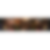
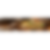
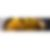
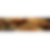
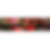
...
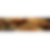
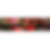
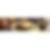
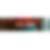
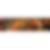

In [96]:
soup = BeautifulSoup(driver.page_source, "html.parser")
soup

In [97]:
links=[]
for i in soup.find_all('a'):
    if i.has_attr('href'):
        a= re.findall("^.*info$",i['href'])
        if len(a)==1:
            links.append(a[0])
links

['/hyderabad/the-glass-house-jubilee-hills/info',
 '/hyderabad/the-glass-house-jubilee-hills/info',
 '/hyderabad/pakka-local-banjara-hills/info',
 '/hyderabad/pakka-local-banjara-hills/info',
 '/hyderabad/navika-cafe-film-nagar/info',
 '/hyderabad/navika-cafe-film-nagar/info',
 '/hyderabad/haiku-banjara-hills/info',
 '/hyderabad/haiku-banjara-hills/info',
 '/hyderabad/exotica-banjara-hills/info',
 '/hyderabad/exotica-banjara-hills/info',
 '/hyderabad/nove-the-italian-kitchen-banjara-hills/info',
 '/hyderabad/nove-the-italian-kitchen-banjara-hills/info',
 '/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 '/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 '/hyderabad/pompeii-pizza-studio-jubilee-hills/info',
 '/hyderabad/pompeii-pizza-studio-jubilee-hills/info',
 '/hyderabad/kavyam-the-telugu-table-jubilee-hills/info',
 '/hyderabad/kavyam-the-telugu-table-jubilee-hills/info',
 '/hyderabad/fly-feel-the-high-1-jubilee-hills/info',
 '/hyderabad/fly-feel-the-high

In [98]:
links[::2]

['/hyderabad/the-glass-house-jubilee-hills/info',
 '/hyderabad/pakka-local-banjara-hills/info',
 '/hyderabad/navika-cafe-film-nagar/info',
 '/hyderabad/haiku-banjara-hills/info',
 '/hyderabad/exotica-banjara-hills/info',
 '/hyderabad/nove-the-italian-kitchen-banjara-hills/info',
 '/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 '/hyderabad/pompeii-pizza-studio-jubilee-hills/info',
 '/hyderabad/kavyam-the-telugu-table-jubilee-hills/info',
 '/hyderabad/fly-feel-the-high-1-jubilee-hills/info',
 '/hyderabad/kortyard-cafe-jubilee-hills/info',
 '/hyderabad/makau-jubilee-hills/info',
 '/hyderabad/blue-block-club-jubilee-hills/info',
 '/hyderabad/babylon-bar-and-kitchen-jubilee-hills/info',
 '/hyderabad/erra-karam-south-indian-resto-bar-jubilee-hills/info',
 '/hyderabad/krishnapatnam-jubilee-hills/info',
 '/hyderabad/lé-vantage-cafe-bar-jubilee-hills/info',
 '/hyderabad/naatu-kitchen-and-bar-jubilee-hills/info',
 '/hyderabad/antera-kitchen-and-bar-jubilee-hills/info',
 '/hydera

In [99]:
len(links[::2])

501

In [100]:
x = []
for i in links[::2]:
    x.append('https://www.zomato.com'+i)
x

['https://www.zomato.com/hyderabad/the-glass-house-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/pakka-local-banjara-hills/info',
 'https://www.zomato.com/hyderabad/navika-cafe-film-nagar/info',
 'https://www.zomato.com/hyderabad/haiku-banjara-hills/info',
 'https://www.zomato.com/hyderabad/exotica-banjara-hills/info',
 'https://www.zomato.com/hyderabad/nove-the-italian-kitchen-banjara-hills/info',
 'https://www.zomato.com/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/pompeii-pizza-studio-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/kavyam-the-telugu-table-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/fly-feel-the-high-1-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/kortyard-cafe-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/makau-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/blue-block-club-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/babylon-bar-and-kitchen-jubil

In [101]:
name = []
cuisine = []
location = []
dining_rating = []
price = []
Takeaway = []
h_delivery = []
delivery_rating = []

for i in x:
    driver = webdriver.Chrome()
    driver.get(i)
    soup = BeautifulSoup(driver.page_source, "html.parser")
    content = soup.find_all('div', class_="sc-fEUNkw gAkuDn")
    
    for i in content:
        
        a = i.find("h1", class_="sc-7kepeu-0 sc-iSDuPN fwzNdh")
        if a:
            name.append(a.text)
        else:
            name.append(np.nan)
        
        b = i.find("div", class_="sc-fgfRvd gBMRZZ")
        if b:
            cuisine.append(b.text)
        else:
            cuisine.append(np.nan)
            
        c = i.find("a", class_="sc-clNaTc vNCcy")
        if c:
            location.append(c.text)
        else:
            location.append(np.nan)
        
        d = i.find("div", class_="sc-1q7bklc-1 cILgox")
        if d:
            dining_rating.append(d.text)
        else:
            dining_rating.append(np.nan)
        
        e = re.findall('₹(.*)\sfor\stwo\speople',i.text)
        if e:
            price.append(e[0])
        else:
            price.append(np.nan)
        
        f = re.findall('Takeaway\sAvailable',i.text)
        if f:
            Takeaway.append("Yes")
        else:
            Takeaway.append('No')
        
        g = re.findall('Home\sDelivery',i.text)
        if g:
            h_delivery.append("Yes")
        else:
            h_delivery.append('No')
            
        h = re.findall('Ratings(\d\.\d)star',i.text)
        if h:
            delivery_rating.append(h[0])
        else:
            delivery_rating.append(np.nan)

driver.quit()

In [102]:
df4 = pd.DataFrame({'Name' :  name, 
                'Cuisines':cuisine, 
                'Location':location, 
                'Dining_rating' :dining_rating,
                 'Price'  :price, 
                'Takeaway':Takeaway,
                'Home_Delivery':h_delivery,
                  'Delivery_rating':delivery_rating})
df4

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,The Glass House,"Modern Indian, Cafe, Asian, Coffee, Desserts, ...","Jubilee Hills, Hyderabad",4.3,"2,000",Yes,Yes,4.0
1,Pakka Local,"Andhra, Kebab, Chinese, North Indian, Biryani,...","Banjara Hills, Hyderabad",4.2,"1,200",Yes,Yes,4.1
2,Navika Cafe,"Pizza, Burger, Pasta, Sandwich, Fast Food, Hea...","Film Nagar, Hyderabad",New,"1,000",Yes,No,NaN
3,Haiku,"Oriental, Chinese, Sushi, Japanese, Korean, Ma...","Banjara Hills, Hyderabad",4.6,"2,400",Yes,Yes,4.4
4,NaN,NaN,NaN,NaN,NaN,No,No,NaN
...,...,...,...,...,...,...,...,...
466,Shahi Dastarkhwan,"North Indian, Chinese, Seafood, Kebab, Mughlai...","Lakdikapul, Hyderabad",4.2,"1,200",Yes,Yes,4.1
467,Alex's Kitchen,"Chinese, Seafood, Beverages","Himayath Nagar, Hyderabad",3.7,700,Yes,Yes,4.2
468,Istanbul,Wraps,"Tolichowki, Hyderabad",4.0,400,Yes,No,NaN
469,Lala's,"Continental, Mexican, Fast Food","Jubilee Hills, Hyderabad",New,"1,000",Yes,No,NaN


In [103]:
df4.isna().sum()

Name                39
Cuisines            39
Location            39
Dining_rating       39
Price               39
Takeaway             0
Home_Delivery        0
Delivery_rating    145
dtype: int64

In [104]:
url_="https://www.zomato.com/hyderabad/hitech-city-restaurants"

In [105]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import re
import numpy as np
import selenium
from selenium import webdriver

In [106]:
driver = webdriver.Chrome()
driver.get(url_)

In [107]:
page =requests.get(url_,headers = {'User-Agent':'Mozilla/5.0'})
page

<Response [200]>

<html data-rh="lang" lang="en-in"><head>
<meta content="width=device-width, initial-scale=1" name="viewport"/>
<link href="https://googleads.g.doubleclick.net" rel="preconnect"/>
<link href="https://jumbo.zomato.com" rel="preconnect"/>
<link href="https://accounts.google.com" rel="preconnect"/>
<link href="https://securepubads.g.doubleclick.net" rel="preconnect"/>
<link href="https://www.google-analytics.com" rel="preconnect"/>
<link href="https://www.googleadservices.com" rel="preconnect"/>
<link href="https://bat.bing.com" rel="preconnect"/>
<link href="https://8391443.fls.doubleclick.net" rel="preconnect"/>
<title>Restaurants in Hitech City - Zomato</title>
<meta charset="utf-8" data-rh="true"/><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-6HC28B0H9G&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-X6B66E85ZJ&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https:/
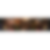
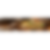
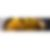
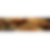
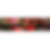
...
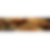
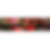
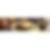
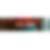
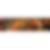

In [108]:
soup = BeautifulSoup(driver.page_source, "html.parser")
soup

In [109]:
links=[]
for i in soup.find_all('a'):
    if i.has_attr('href'):
        a= re.findall("^.*info$",i['href'])
        if len(a)==1:
            links.append(a[0])
links

['/hyderabad/over-the-moon-brew-company-gachibowli/info',
 '/hyderabad/over-the-moon-brew-company-gachibowli/info',
 '/hyderabad/the-glass-house-jubilee-hills/info',
 '/hyderabad/the-glass-house-jubilee-hills/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/tabula-rasa-gachibowli/info',
 '/hyderabad/tabula-rasa-gachibowli/info',
 '/hyderabad/haiku-gachibowli/info',
 '/hyderabad/haiku-gachibowli/info',
 '/hyderabad/cock-bull-madhapur/info',
 '/hyderabad/cock-bull-madhapur/info',
 '/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 '/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 '/hyderabad/ohris-rubaiyat-hitech-city/info',
 '/hyderabad/ohris-rubaiyat-hitech-city/info',
 '/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 '/hyderabad/na

In [110]:
links[::2]

['/hyderabad/over-the-moon-brew-company-gachibowli/info',
 '/hyderabad/the-glass-house-jubilee-hills/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/tabula-rasa-gachibowli/info',
 '/hyderabad/haiku-gachibowli/info',
 '/hyderabad/cock-bull-madhapur/info',
 '/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 '/hyderabad/ohris-rubaiyat-hitech-city/info',
 '/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 '/hyderabad/sesame-gachibowli/info',
 '/hyderabad/makau-jubilee-hills/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/babylon-bar-and-kitchen-jubilee-hills/info',
 '/hyderabad/pompeii-pizza-studio-madhapur/info',
 '/hyderabad/antera-kitchen-and-bar-gachibowli/info',
 '/hyderabad/hard-rock-cafe-hitech-city/info',
 '/hyderabad/barbeque-holic-kondapur/info',
 '/hyderabad/red-rhino-hitech-city/info',
 '/hyderabad/krishnapatnam-jubilee-hills/info',
 '/hyderabad/b

In [111]:
len(links[::2])

500

In [112]:
x = []
for i in links[::2]:
    x.append('https://www.zomato.com'+i)
x

['https://www.zomato.com/hyderabad/over-the-moon-brew-company-gachibowli/info',
 'https://www.zomato.com/hyderabad/the-glass-house-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 'https://www.zomato.com/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 'https://www.zomato.com/hyderabad/tabula-rasa-gachibowli/info',
 'https://www.zomato.com/hyderabad/haiku-gachibowli/info',
 'https://www.zomato.com/hyderabad/cock-bull-madhapur/info',
 'https://www.zomato.com/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 'https://www.zomato.com/hyderabad/ohris-rubaiyat-hitech-city/info',
 'https://www.zomato.com/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/sesame-gachibowli/info',
 'https://www.zomato.com/hyderabad/makau-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/exotica-hitech-city/info',
 'https://www.zomato.com/hyderabad/babylon-bar-and-kitchen-jubilee-hill

In [113]:
name = []
cuisine = []
location = []
dining_rating = []
price = []
Takeaway = []
h_delivery = []
delivery_rating = []

for i in x:
    driver = webdriver.Chrome()
    driver.get(i)
    soup = BeautifulSoup(driver.page_source, "html.parser")
    content = soup.find_all('div', class_="sc-fEUNkw gAkuDn")
    
    for i in content:
        
        a = i.find("h1", class_="sc-7kepeu-0 sc-iSDuPN fwzNdh")
        if a:
            name.append(a.text)
        else:
            name.append(np.nan)
        
        b = i.find("div", class_="sc-fgfRvd gBMRZZ")
        if b:
            cuisine.append(b.text)
        else:
            cuisine.append(np.nan)
            
        c = i.find("a", class_="sc-clNaTc vNCcy")
        if c:
            location.append(c.text)
        else:
            location.append(np.nan)
        
        d = i.find("div", class_="sc-1q7bklc-1 cILgox")
        if d:
            dining_rating.append(d.text)
        else:
            dining_rating.append(np.nan)
        
        e = re.findall('₹(.*)\sfor\stwo\speople',i.text)
        if e:
            price.append(e[0])
        else:
            price.append(np.nan)
        
        f = re.findall('Takeaway\sAvailable',i.text)
        if f:
            Takeaway.append("Yes")
        else:
            Takeaway.append('No')
        
        g = re.findall('Home\sDelivery',i.text)
        if g:
            h_delivery.append("Yes")
        else:
            h_delivery.append('No')
            
        h = re.findall('Ratings(\d\.\d)star',i.text)
        if h:
            delivery_rating.append(h[0])
        else:
            delivery_rating.append(np.nan)

driver.quit()

In [114]:
df5 = pd.DataFrame({'Name' :  name, 
                'Cuisines':cuisine, 
                'Location':location, 
                'Dining_rating' :dining_rating,
                 'Price'  :price, 
                'Takeaway':Takeaway,
                'Home_Delivery':h_delivery,
                  'Delivery_rating':delivery_rating})
df5

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,Over The Moon Brew Company,"Asian, Continental, North Indian, Italian, Mom...","Gachibowli, Hyderabad",4.9,"3,000",No,Yes,4.4
1,The Glass House,"Modern Indian, Cafe, Asian, Coffee, Desserts, ...","Jubilee Hills, Hyderabad",4.3,"2,000",Yes,Yes,4.0
2,Sahib’s Barbeque By Ohri’s,"Hyderabadi, Awadhi, North Indian, Mughlai, Ice...","Hitech City, Hyderabad",4.2,"1,700",Yes,Yes,3.5
3,Elsewhere Lounge & Kitchen,"North Indian, Mughlai, Continental, Pizza, Pas...","Gachibowli, Hyderabad",4.2,"2,000",Yes,No,NaN
4,Haiku,"Oriental, Chinese, Sushi, Japanese, Korean, Ma...","Gachibowli, Hyderabad",4.8,"2,400",Yes,Yes,4.3
...,...,...,...,...,...,...,...,...
474,Vibrant Living,"Cafe, Beverages, Healthy Food, Chinese, Contin...","Jubilee Hills, Hyderabad",3.9,750,Yes,Yes,4.1
475,Mohammedias Shawarma,"Shawarma, Kebab","Manikonda, Hyderabad",3.6,300,Yes,Yes,3.5
476,NaN,NaN,NaN,NaN,NaN,No,No,NaN
477,Mota Kababi,"Rolls, North Indian, Bihari, Kebab, Awadhi, Mu...","Kondapur, Hyderabad",4.7,600,Yes,No,NaN


In [115]:
url_ = 'https://www.zomato.com/hyderabad/madhapur-restaurants'

In [116]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import re
import numpy as np
import selenium
from selenium import webdriver

In [117]:
driver = webdriver.Chrome()
driver.get(url_)

In [118]:
page =requests.get(url_,headers = {'User-Agent':'Mozilla/5.0'})
page

<Response [200]>

<html data-rh="lang" lang="en-in"><head>
<meta content="width=device-width, initial-scale=1" name="viewport"/>
<link href="https://googleads.g.doubleclick.net" rel="preconnect"/>
<link href="https://jumbo.zomato.com" rel="preconnect"/>
<link href="https://accounts.google.com" rel="preconnect"/>
<link href="https://securepubads.g.doubleclick.net" rel="preconnect"/>
<link href="https://www.google-analytics.com" rel="preconnect"/>
<link href="https://www.googleadservices.com" rel="preconnect"/>
<link href="https://bat.bing.com" rel="preconnect"/>
<link href="https://8391443.fls.doubleclick.net" rel="preconnect"/>
<title>Restaurants in Madhapur - Zomato</title>
<meta charset="utf-8" data-rh="true"/><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-X6B66E85ZJ&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-6HC28B0H9G&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://ww
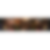
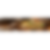
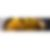
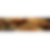
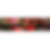
...
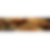
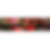
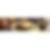
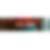
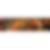

In [119]:
soup = BeautifulSoup(driver.page_source, "html.parser")
soup

In [120]:
links=[]
for i in soup.find_all('a'):
    if i.has_attr('href'):
        a= re.findall("^.*info$",i['href'])
        if len(a)==1:
            links.append(a[0])
links

['/hyderabad/the-glass-house-jubilee-hills/info',
 '/hyderabad/the-glass-house-jubilee-hills/info',
 '/hyderabad/over-the-moon-brew-company-gachibowli/info',
 '/hyderabad/over-the-moon-brew-company-gachibowli/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 '/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 '/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 '/hyderabad/cock-bull-madhapur/info',
 '/hyderabad/cock-bull-madhapur/info',
 '/hyderabad/pompeii-pizza-studio-madhapur/info',
 '/hyderabad/pompeii-pizza-studio-madhapur/info',
 '/hyderabad/haiku-gachi

In [121]:
links[::2]

['/hyderabad/the-glass-house-jubilee-hills/info',
 '/hyderabad/over-the-moon-brew-company-gachibowli/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 '/hyderabad/cock-bull-madhapur/info',
 '/hyderabad/pompeii-pizza-studio-madhapur/info',
 '/hyderabad/haiku-gachibowli/info',
 '/hyderabad/ohris-rubaiyat-hitech-city/info',
 '/hyderabad/makau-jubilee-hills/info',
 '/hyderabad/hard-rock-cafe-hitech-city/info',
 '/hyderabad/babylon-bar-and-kitchen-jubilee-hills/info',
 '/hyderabad/bel-posto-the-cafe-1-jubilee-hills/info',
 '/hyderabad/barbeque-holic-kondapur/info',
 '/hyderabad/komma-the-club-kothaguda/info',
 '/hyderabad/krishnapatnam-jubilee-hills/info',
 '/hyderabad/ta-ma-sha-restro-cafe-jubilee-hills/info',
 '/hyderabad/naatu-kitchen-and-bar-

In [122]:
len(links[::2])

501

In [123]:
x = []
for i in links[::2]:
    x.append('https://www.zomato.com'+i)
x

['https://www.zomato.com/hyderabad/the-glass-house-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/over-the-moon-brew-company-gachibowli/info',
 'https://www.zomato.com/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 'https://www.zomato.com/hyderabad/nataka-global-kitchen-and-cafe-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 'https://www.zomato.com/hyderabad/exotica-hitech-city/info',
 'https://www.zomato.com/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 'https://www.zomato.com/hyderabad/cock-bull-madhapur/info',
 'https://www.zomato.com/hyderabad/pompeii-pizza-studio-madhapur/info',
 'https://www.zomato.com/hyderabad/haiku-gachibowli/info',
 'https://www.zomato.com/hyderabad/ohris-rubaiyat-hitech-city/info',
 'https://www.zomato.com/hyderabad/makau-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/hard-rock-cafe-hitech-city/info',
 'https://www.zomato.com/hyderabad/babylon-bar-and-kitc

In [124]:
name = []
cuisine = []
location = []
dining_rating = []
price = []
Takeaway = []
h_delivery = []
delivery_rating = []

for i in x:
    driver = webdriver.Chrome()
    driver.get(i)
    soup = BeautifulSoup(driver.page_source, "html.parser")
    content = soup.find_all('div', class_="sc-fEUNkw gAkuDn")
    
    for i in content:
        
        a = i.find("h1", class_="sc-7kepeu-0 sc-iSDuPN fwzNdh")
        if a:
            name.append(a.text)
        else:
            name.append(np.nan)
        
        b = i.find("div", class_="sc-fgfRvd gBMRZZ")
        if b:
            cuisine.append(b.text)
        else:
            cuisine.append(np.nan)
            
        c = i.find("a", class_="sc-clNaTc vNCcy")
        if c:
            location.append(c.text)
        else:
            location.append(np.nan)
        
        d = i.find("div", class_="sc-1q7bklc-1 cILgox")
        if d:
            dining_rating.append(d.text)
        else:
            dining_rating.append(np.nan)
        
        e = re.findall('₹(.*)\sfor\stwo\speople',i.text)
        if e:
            price.append(e[0])
        else:
            price.append(np.nan)
        
        f = re.findall('Takeaway\sAvailable',i.text)
        if f:
            Takeaway.append("Yes")
        else:
            Takeaway.append('No')
        
        g = re.findall('Home\sDelivery',i.text)
        if g:
            h_delivery.append("Yes")
        else:
            h_delivery.append('No')
            
        h = re.findall('Ratings(\d\.\d)star',i.text)
        if h:
            delivery_rating.append(h[0])
        else:
            delivery_rating.append(np.nan)

driver.quit()

In [125]:
df6 = pd.DataFrame({'Name' :  name, 
                'Cuisines':cuisine, 
                'Location':location, 
                'Dining_rating' :dining_rating,
                 'Price'  :price, 
                'Takeaway':Takeaway,
                'Home_Delivery':h_delivery,
                  'Delivery_rating':delivery_rating})
df6

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,The Glass House,"Modern Indian, Cafe, Asian, Coffee, Desserts, ...","Jubilee Hills, Hyderabad",4.3,"2,000",Yes,Yes,4.0
1,Over The Moon Brew Company,"Asian, Continental, North Indian, Italian, Mom...","Gachibowli, Hyderabad",4.9,"3,000",No,Yes,4.4
2,Sahib’s Barbeque By Ohri’s,"Hyderabadi, Awadhi, North Indian, Mughlai, Ice...","Hitech City, Hyderabad",4.2,"1,700",Yes,Yes,3.5
3,Nataka Global Kitchen And Cafe,"Continental, Asian, Thai, Andhra, Italian, Chi...","Jubilee Hills, Hyderabad",4.3,"1,500",Yes,Yes,4.3
4,Elsewhere Lounge & Kitchen,"North Indian, Mughlai, Continental, Pizza, Pas...","Gachibowli, Hyderabad",4.2,"2,000",Yes,No,NaN
...,...,...,...,...,...,...,...,...
471,Green Bawarchi Restaurant,"Chinese, Mughlai, North Indian, Seafood, Mandi...","Gachibowli, Hyderabad",3.0,"1,100",Yes,Yes,3.6
472,Chai Point,"Tea, Coffee, Beverages, Shake, Fast Food, Roll...","Hitech City, Hyderabad",3.1,250,Yes,Yes,4.0
473,Rajahmundrys Srinivasa Mixture Point,"Street Food, Shake","Madhapur, Hyderabad",2.8,300,Yes,Yes,4.0
474,Vibrant Living,"Cafe, Beverages, Healthy Food, Chinese, Contin...","Jubilee Hills, Hyderabad",3.9,750,Yes,Yes,4.1


In [126]:
url_ = 'https://www.zomato.com/hyderabad/kondapur-restaurants'

In [127]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import re
import numpy as np
import selenium
from selenium import webdriver

In [128]:
driver = webdriver.Chrome()
driver.get(url_)

In [129]:
page =requests.get(url_,headers = {'User-Agent':'Mozilla/5.0'})
page

<Response [200]>

<html data-rh="lang" lang="en-in"><head>
<meta content="width=device-width, initial-scale=1" name="viewport"/>
<link href="https://googleads.g.doubleclick.net" rel="preconnect"/>
<link href="https://jumbo.zomato.com" rel="preconnect"/>
<link href="https://accounts.google.com" rel="preconnect"/>
<link href="https://securepubads.g.doubleclick.net" rel="preconnect"/>
<link href="https://www.google-analytics.com" rel="preconnect"/>
<link href="https://www.googleadservices.com" rel="preconnect"/>
<link href="https://bat.bing.com" rel="preconnect"/>
<link href="https://8391443.fls.doubleclick.net" rel="preconnect"/>
<title>Restaurants in Kondapur - Zomato</title>
<meta charset="utf-8" data-rh="true"/><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-X6B66E85ZJ&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-6HC28B0H9G&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://ww
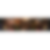
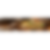
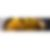
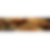
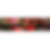
...
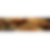
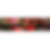
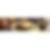
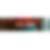
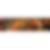

In [130]:
soup = BeautifulSoup(driver.page_source, "html.parser")
soup

In [131]:
links=[]
for i in soup.find_all('a'):
    if i.has_attr('href'):
        a= re.findall("^.*info$",i['href'])
        if len(a)==1:
            links.append(a[0])
links

['/hyderabad/over-the-moon-brew-company-gachibowli/info',
 '/hyderabad/over-the-moon-brew-company-gachibowli/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/haiku-gachibowli/info',
 '/hyderabad/haiku-gachibowli/info',
 '/hyderabad/brews-blends-kondapur/info',
 '/hyderabad/brews-blends-kondapur/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/komma-the-club-kothaguda/info',
 '/hyderabad/komma-the-club-kothaguda/info',
 '/hyderabad/ohris-rubaiyat-hitech-city/info',
 '/hyderabad/ohris-rubaiyat-hitech-city/info',
 '/hyderabad/sesame-gachibowli/info',
 '/hyderabad/sesame-gachibowli/info',
 '/hyderabad/cock-bull-madhapur/info',
 '/hyderabad/cock-bull-madhapur/info',
 '/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 '/hydera

In [132]:
links[::2]

['/hyderabad/over-the-moon-brew-company-gachibowli/info',
 '/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 '/hyderabad/haiku-gachibowli/info',
 '/hyderabad/brews-blends-kondapur/info',
 '/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/komma-the-club-kothaguda/info',
 '/hyderabad/ohris-rubaiyat-hitech-city/info',
 '/hyderabad/sesame-gachibowli/info',
 '/hyderabad/cock-bull-madhapur/info',
 '/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 '/hyderabad/makau-jubilee-hills/info',
 '/hyderabad/pompeii-pizza-studio-madhapur/info',
 '/hyderabad/antera-kitchen-and-bar-gachibowli/info',
 '/hyderabad/red-rhino-hitech-city/info',
 '/hyderabad/barbeque-holic-kondapur/info',
 '/hyderabad/hard-rock-cafe-hitech-city/info',
 '/hyderabad/air-live-gachibowli/info',
 '/hyderabad/mamagoto-kondapur/info',
 '/hyderabad/president-dhaba-madhapur/info',
 '/hyderabad/ta-ma-sha-restro-cafe-jubilee-hills/info',
 '/hyderabad

In [133]:
len(links[::2])

501

In [134]:
x = []
for i in links[::2]:
    x.append('https://www.zomato.com'+i)
x

['https://www.zomato.com/hyderabad/over-the-moon-brew-company-gachibowli/info',
 'https://www.zomato.com/hyderabad/sahibs-barbeque-by-ohris-hitech-city/info',
 'https://www.zomato.com/hyderabad/haiku-gachibowli/info',
 'https://www.zomato.com/hyderabad/brews-blends-kondapur/info',
 'https://www.zomato.com/hyderabad/elsewhere-lounge-kitchen-gachibowli/info',
 'https://www.zomato.com/hyderabad/exotica-hitech-city/info',
 'https://www.zomato.com/hyderabad/komma-the-club-kothaguda/info',
 'https://www.zomato.com/hyderabad/ohris-rubaiyat-hitech-city/info',
 'https://www.zomato.com/hyderabad/sesame-gachibowli/info',
 'https://www.zomato.com/hyderabad/cock-bull-madhapur/info',
 'https://www.zomato.com/hyderabad/tevar-the-progressive-indian-kitchen-bar-hitech-city/info',
 'https://www.zomato.com/hyderabad/makau-jubilee-hills/info',
 'https://www.zomato.com/hyderabad/pompeii-pizza-studio-madhapur/info',
 'https://www.zomato.com/hyderabad/antera-kitchen-and-bar-gachibowli/info',
 'https://www.zo

In [135]:
name = []
cuisine = []
location = []
dining_rating = []
price = []
Takeaway = []
h_delivery = []
delivery_rating = []

for i in x:
    driver = webdriver.Chrome()
    driver.get(i)
    soup = BeautifulSoup(driver.page_source, "html.parser")
    content = soup.find_all('div', class_="sc-fEUNkw gAkuDn")
    
    for i in content:
        
        a = i.find("h1", class_="sc-7kepeu-0 sc-iSDuPN fwzNdh")
        if a:
            name.append(a.text)
        else:
            name.append(np.nan)
        
        b = i.find("div", class_="sc-fgfRvd gBMRZZ")
        if b:
            cuisine.append(b.text)
        else:
            cuisine.append(np.nan)
            
        c = i.find("a", class_="sc-clNaTc vNCcy")
        if c:
            location.append(c.text)
        else:
            location.append(np.nan)
        
        d = i.find("div", class_="sc-1q7bklc-1 cILgox")
        if d:
            dining_rating.append(d.text)
        else:
            dining_rating.append(np.nan)
        
        e = re.findall('₹(.*)\sfor\stwo\speople',i.text)
        if e:
            price.append(e[0])
        else:
            price.append(np.nan)
        
        f = re.findall('Takeaway\sAvailable',i.text)
        if f:
            Takeaway.append("Yes")
        else:
            Takeaway.append('No')
        
        g = re.findall('Home\sDelivery',i.text)
        if g:
            h_delivery.append("Yes")
        else:
            h_delivery.append('No')
            
        h = re.findall('Ratings(\d\.\d)star',i.text)
        if h:
            delivery_rating.append(h[0])
        else:
            delivery_rating.append(np.nan)

driver.quit()

In [136]:
df7 = pd.DataFrame({'Name' :  name, 
                'Cuisines':cuisine, 
                'Location':location, 
                'Dining_rating' :dining_rating,
                 'Price'  :price, 
                'Takeaway':Takeaway,
                'Home_Delivery':h_delivery,
                  'Delivery_rating':delivery_rating})
df7

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,Over The Moon Brew Company,"Asian, Continental, North Indian, Italian, Mom...","Gachibowli, Hyderabad",4.9,"3,000",No,Yes,4.4
1,Sahib’s Barbeque By Ohri’s,"Hyderabadi, Awadhi, North Indian, Mughlai, Ice...","Hitech City, Hyderabad",4.2,"1,700",Yes,Yes,3.5
2,Haiku,"Oriental, Chinese, Sushi, Japanese, Korean, Ma...","Gachibowli, Hyderabad",4.8,"2,400",Yes,Yes,4.3
3,Brews & Blends,"Continental, Italian, Pizza, Burger, Fast Food...","Kondapur, Hyderabad",4.5,"1,500",Yes,No,4.0
4,Elsewhere Lounge & Kitchen,"North Indian, Mughlai, Continental, Pizza, Pas...","Gachibowli, Hyderabad",4.2,"2,000",Yes,No,NaN
...,...,...,...,...,...,...,...,...
477,Kolkata Food Plaza,"Bengali, North Indian, Chinese, Fast Food","Hitech City, Hyderabad",2.4,550,Yes,Yes,4.1
478,Ababeel Green Bawarchi,"Mandi, Biryani, North Indian, Chinese","Miyapur, Hyderabad",3.3,500,Yes,Yes,3.8
479,Hotel Orchid Grand,"North Indian, Chinese, Seafood, Mughlai, Biryani","Miyapur, Hyderabad",3.8,600,Yes,Yes,3.7
480,Chicken Shawarma Hub,"Shawarma, Fast Food, Beverages","Kukatpally, Hyderabad",4.0,300,Yes,Yes,4.1


In [149]:
url_ = 'https://www.zomato.com/hyderabad/lb-nagar-restaurants'

In [150]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import re
import numpy as np
import selenium
from selenium import webdriver

In [151]:
driver = webdriver.Chrome()
driver.get(url_)

In [153]:
page =requests.get(url_,headers = {'User-Agent':'Mozilla/5.0'})
page

<Response [200]>

<html data-rh="lang" lang="en-in"><head>
<meta content="width=device-width, initial-scale=1" name="viewport"/>
<link href="https://googleads.g.doubleclick.net" rel="preconnect"/>
<link href="https://jumbo.zomato.com" rel="preconnect"/>
<link href="https://accounts.google.com" rel="preconnect"/>
<link href="https://securepubads.g.doubleclick.net" rel="preconnect"/>
<link href="https://www.google-analytics.com" rel="preconnect"/>
<link href="https://www.googleadservices.com" rel="preconnect"/>
<link href="https://bat.bing.com" rel="preconnect"/>
<link href="https://8391443.fls.doubleclick.net" rel="preconnect"/>
<title>Restaurants in L B Nagar - Zomato</title>
<meta charset="utf-8" data-rh="true"/><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-X6B66E85ZJ&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-2XVFHLPTVP&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://w
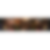
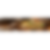
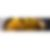
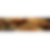
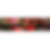
...
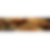
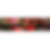
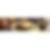
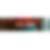
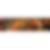

In [154]:
soup = BeautifulSoup(driver.page_source, "html.parser")
soup

In [155]:
links=[]
for i in soup.find_all('a'):
    if i.has_attr('href'):
        a= re.findall("^.*info$",i['href'])
        if len(a)==1:
            links.append(a[0])
links

['/hyderabad/dasara-1-nagole/info',
 '/hyderabad/dasara-1-nagole/info',
 '/hyderabad/abs-absolute-barbecues-vanasthalipuram/info',
 '/hyderabad/abs-absolute-barbecues-vanasthalipuram/info',
 '/hyderabad/flechazo-kothapet/info',
 '/hyderabad/flechazo-kothapet/info',
 '/hyderabad/1989-pizza-thick-shakes-l-b-nagar/info',
 '/hyderabad/1989-pizza-thick-shakes-l-b-nagar/info',
 '/hyderabad/platform-65-dilsukhnagar/info',
 '/hyderabad/platform-65-dilsukhnagar/info',
 '/hyderabad/hotel-sitara-grand-l-b-nagar/info',
 '/hyderabad/hotel-sitara-grand-l-b-nagar/info',
 '/hyderabad/forbes-cafe-restaurant-dilsukhnagar/info',
 '/hyderabad/forbes-cafe-restaurant-dilsukhnagar/info',
 '/hyderabad/encanto-nagole/info',
 '/hyderabad/encanto-nagole/info',
 '/hyderabad/kefi-nagole/info',
 '/hyderabad/kefi-nagole/info',
 '/hyderabad/sehari-cafe-nagole/info',
 '/hyderabad/sehari-cafe-nagole/info',
 '/hyderabad/paradise-biryani-a-legend-since-1953-kothapet/info',
 '/hyderabad/paradise-biryani-a-legend-since-195

In [156]:
links[::2]

['/hyderabad/dasara-1-nagole/info',
 '/hyderabad/abs-absolute-barbecues-vanasthalipuram/info',
 '/hyderabad/flechazo-kothapet/info',
 '/hyderabad/1989-pizza-thick-shakes-l-b-nagar/info',
 '/hyderabad/platform-65-dilsukhnagar/info',
 '/hyderabad/hotel-sitara-grand-l-b-nagar/info',
 '/hyderabad/forbes-cafe-restaurant-dilsukhnagar/info',
 '/hyderabad/encanto-nagole/info',
 '/hyderabad/kefi-nagole/info',
 '/hyderabad/sehari-cafe-nagole/info',
 '/hyderabad/paradise-biryani-a-legend-since-1953-kothapet/info',
 '/hyderabad/1989-milkshakes-1-dilsukhnagar/info',
 '/hyderabad/ankapur-village-a-military-hotel-vanasthalipuram/info',
 '/hyderabad/sanjos-donuts-dilsukhnagar/info',
 '/hyderabad/chinese-wok-kothapet/info',
 '/hyderabad/the-pluto-cafe-malakpet/info',
 '/hyderabad/hotel-shubham-palace-1-saroor-nagar/info',
 '/hyderabad/cloud-kitchen-dilsukhnagar/info',
 '/hyderabad/hotel-swagath-grand-nagole/info',
 '/hyderabad/jeevyas-indinental-eats-dilsukhnagar/info',
 '/hyderabad/cafe-maxibrew-1-kot

In [157]:
len(links[::2])

501

In [158]:
x = []
for i in links[::2]:
    x.append('https://www.zomato.com'+i)
x

['https://www.zomato.com/hyderabad/dasara-1-nagole/info',
 'https://www.zomato.com/hyderabad/abs-absolute-barbecues-vanasthalipuram/info',
 'https://www.zomato.com/hyderabad/flechazo-kothapet/info',
 'https://www.zomato.com/hyderabad/1989-pizza-thick-shakes-l-b-nagar/info',
 'https://www.zomato.com/hyderabad/platform-65-dilsukhnagar/info',
 'https://www.zomato.com/hyderabad/hotel-sitara-grand-l-b-nagar/info',
 'https://www.zomato.com/hyderabad/forbes-cafe-restaurant-dilsukhnagar/info',
 'https://www.zomato.com/hyderabad/encanto-nagole/info',
 'https://www.zomato.com/hyderabad/kefi-nagole/info',
 'https://www.zomato.com/hyderabad/sehari-cafe-nagole/info',
 'https://www.zomato.com/hyderabad/paradise-biryani-a-legend-since-1953-kothapet/info',
 'https://www.zomato.com/hyderabad/1989-milkshakes-1-dilsukhnagar/info',
 'https://www.zomato.com/hyderabad/ankapur-village-a-military-hotel-vanasthalipuram/info',
 'https://www.zomato.com/hyderabad/sanjos-donuts-dilsukhnagar/info',
 'https://www.zo

In [159]:
name = []
cuisine = []
location = []
dining_rating = []
price = []
Takeaway = []
h_delivery = []
delivery_rating = []

for i in x:
    driver = webdriver.Chrome()
    driver.get(i)
    soup = BeautifulSoup(driver.page_source, "html.parser")
    content = soup.find_all('div', class_="sc-fEUNkw gAkuDn")
    
    for i in content:
        
        a = i.find("h1", class_="sc-7kepeu-0 sc-iSDuPN fwzNdh")
        if a:
            name.append(a.text)
        else:
            name.append(np.nan)
        
        b = i.find("div", class_="sc-fgfRvd gBMRZZ")
        if b:
            cuisine.append(b.text)
        else:
            cuisine.append(np.nan)
            
        c = i.find("a", class_="sc-clNaTc vNCcy")
        if c:
            location.append(c.text)
        else:
            location.append(np.nan)
        
        d = i.find("div", class_="sc-1q7bklc-1 cILgox")
        if d:
            dining_rating.append(d.text)
        else:
            dining_rating.append(np.nan)
        
        e = re.findall('₹(.*)\sfor\stwo\speople',i.text)
        if e:
            price.append(e[0])
        else:
            price.append(np.nan)
        
        f = re.findall('Takeaway\sAvailable',i.text)
        if f:
            Takeaway.append("Yes")
        else:
            Takeaway.append('No')
        
        g = re.findall('Home\sDelivery',i.text)
        if g:
            h_delivery.append("Yes")
        else:
            h_delivery.append('No')
            
        h = re.findall('Ratings(\d\.\d)star',i.text)
        if h:
            delivery_rating.append(h[0])
        else:
            delivery_rating.append(np.nan)

driver.quit()

In [160]:
df8 = pd.DataFrame({'Name' :  name, 
                'Cuisines':cuisine, 
                'Location':location, 
                'Dining_rating' :dining_rating,
                 'Price'  :price, 
                'Takeaway':Takeaway,
                'Home_Delivery':h_delivery,
                  'Delivery_rating':delivery_rating})
df8

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,Dasara,"South Indian, North Indian, Biryani, Mughlai, ...","Nagole, Hyderabad",3.7,"1,200",Yes,Yes,4.0
1,AB's - Absolute Barbecues,"BBQ, North Indian, Desserts","Vanasthalipuram, Hyderabad",4.3,"1,850",Yes,Yes,3.4
2,Flechazo,"Mediterranean, Salad, Fast Food, North Indian","Kothapet, Hyderabad",4.2,"1,600",Yes,Yes,3.8
3,1989 Pizza & Thick Shake's,"Pizza, Sandwich, Burger, Pasta, Fast Food, Des...","L B Nagar, Hyderabad",3.8,400,Yes,Yes,3.9
4,Platform 65,"North Indian, Chinese, South Indian, Biryani, ...","Dilsukhnagar, Hyderabad",3.9,950,Yes,Yes,3.8
...,...,...,...,...,...,...,...,...
478,Royal Food Court,"Chinese, Sichuan","Nagole, Hyderabad",-,300,Yes,Yes,NaN
479,Manideva Food Court,Chinese,"Saroor Nagar, Hyderabad",-,200,Yes,Yes,NaN
480,SL Food Court,"Biryani, Chinese, Sichuan","Vanasthalipuram, Hyderabad",-,400,Yes,Yes,NaN
481,NaN,NaN,NaN,NaN,NaN,No,No,NaN


In [161]:
url_='https://www.zomato.com/hyderabad/uppal-restaurants'

In [162]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import re
import numpy as np
import selenium
from selenium import webdriver

In [163]:
driver = webdriver.Chrome()
driver.get(url_)

In [164]:
page =requests.get(url_,headers = {'User-Agent':'Mozilla/5.0'})
page

<Response [200]>

<html data-rh="lang" lang="en-in"><head>
<meta content="width=device-width, initial-scale=1" name="viewport"/>
<link href="https://googleads.g.doubleclick.net" rel="preconnect"/>
<link href="https://jumbo.zomato.com" rel="preconnect"/>
<link href="https://accounts.google.com" rel="preconnect"/>
<link href="https://securepubads.g.doubleclick.net" rel="preconnect"/>
<link href="https://www.google-analytics.com" rel="preconnect"/>
<link href="https://www.googleadservices.com" rel="preconnect"/>
<link href="https://bat.bing.com" rel="preconnect"/>
<link href="https://8391443.fls.doubleclick.net" rel="preconnect"/>
<title>Restaurants in Uppal - Zomato</title>
<meta charset="utf-8" data-rh="true"/><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-X6B66E85ZJ&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-6HC28B0H9G&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://www.g
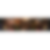
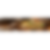
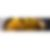
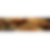
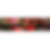
...
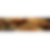
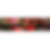
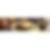
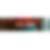
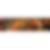

In [165]:
soup = BeautifulSoup(driver.page_source, "html.parser")
soup

In [166]:
links=[]
for i in soup.find_all('a'):
    if i.has_attr('href'):
        a= re.findall("^.*info$",i['href'])
        if len(a)==1:
            links.append(a[0])
links

['/hyderabad/dasara-1-nagole/info',
 '/hyderabad/dasara-1-nagole/info',
 '/hyderabad/lifafa-cafe-bistro-1-uppal-secunderabad/info',
 '/hyderabad/lifafa-cafe-bistro-1-uppal-secunderabad/info',
 '/hyderabad/abs-absolute-barbecues-boduppal/info',
 '/hyderabad/abs-absolute-barbecues-boduppal/info',
 '/hyderabad/vave-pub-nagole/info',
 '/hyderabad/vave-pub-nagole/info',
 '/hyderabad/barbeque-nation-uppal-secunderabad/info',
 '/hyderabad/barbeque-nation-uppal-secunderabad/info',
 '/hyderabad/wow-momo-uppal-secunderabad/info',
 '/hyderabad/wow-momo-uppal-secunderabad/info',
 '/hyderabad/encanto-nagole/info',
 '/hyderabad/encanto-nagole/info',
 '/hyderabad/kefi-nagole/info',
 '/hyderabad/kefi-nagole/info',
 '/hyderabad/taste-factory-restaurant-mallapur-secunderabad/info',
 '/hyderabad/taste-factory-restaurant-mallapur-secunderabad/info',
 '/hyderabad/hotel-kinara-grand-ramanthapur/info',
 '/hyderabad/hotel-kinara-grand-ramanthapur/info',
 '/hyderabad/sehari-cafe-nagole/info',
 '/hyderabad/seha

In [167]:
len(links[::2])

501

In [168]:
x = []
for i in links[::2]:
    x.append('https://www.zomato.com'+i)
x

['https://www.zomato.com/hyderabad/dasara-1-nagole/info',
 'https://www.zomato.com/hyderabad/lifafa-cafe-bistro-1-uppal-secunderabad/info',
 'https://www.zomato.com/hyderabad/abs-absolute-barbecues-boduppal/info',
 'https://www.zomato.com/hyderabad/vave-pub-nagole/info',
 'https://www.zomato.com/hyderabad/barbeque-nation-uppal-secunderabad/info',
 'https://www.zomato.com/hyderabad/wow-momo-uppal-secunderabad/info',
 'https://www.zomato.com/hyderabad/encanto-nagole/info',
 'https://www.zomato.com/hyderabad/kefi-nagole/info',
 'https://www.zomato.com/hyderabad/taste-factory-restaurant-mallapur-secunderabad/info',
 'https://www.zomato.com/hyderabad/hotel-kinara-grand-ramanthapur/info',
 'https://www.zomato.com/hyderabad/sehari-cafe-nagole/info',
 'https://www.zomato.com/hyderabad/cartel-cafe-bistro-habsiguda/info',
 'https://www.zomato.com/hyderabad/frykiki-habsiguda/info',
 'https://www.zomato.com/hyderabad/dumont-creamery-habsiguda/info',
 'https://www.zomato.com/hyderabad/1989-milkshak

In [169]:
name = []
cuisine = []
location = []
dining_rating = []
price = []
Takeaway = []
h_delivery = []
delivery_rating = []

for i in x:
    driver = webdriver.Chrome()
    driver.get(i)
    soup = BeautifulSoup(driver.page_source, "html.parser")
    content = soup.find_all('div', class_="sc-fEUNkw gAkuDn")
    
    for i in content:
        
        a = i.find("h1", class_="sc-7kepeu-0 sc-iSDuPN fwzNdh")
        if a:
            name.append(a.text)
        else:
            name.append(np.nan)
        
        b = i.find("div", class_="sc-fgfRvd gBMRZZ")
        if b:
            cuisine.append(b.text)
        else:
            cuisine.append(np.nan)
            
        c = i.find("a", class_="sc-clNaTc vNCcy")
        if c:
            location.append(c.text)
        else:
            location.append(np.nan)
        
        d = i.find("div", class_="sc-1q7bklc-1 cILgox")
        if d:
            dining_rating.append(d.text)
        else:
            dining_rating.append(np.nan)
        
        e = re.findall('₹(.*)\sfor\stwo\speople',i.text)
        if e:
            price.append(e[0])
        else:
            price.append(np.nan)
        
        f = re.findall('Takeaway\sAvailable',i.text)
        if f:
            Takeaway.append("Yes")
        else:
            Takeaway.append('No')
        
        g = re.findall('Home\sDelivery',i.text)
        if g:
            h_delivery.append("Yes")
        else:
            h_delivery.append('No')
            
        h = re.findall('Ratings(\d\.\d)star',i.text)
        if h:
            delivery_rating.append(h[0])
        else:
            delivery_rating.append(np.nan)

driver.quit()

In [170]:
df9 = pd.DataFrame({'Name' :  name, 
                'Cuisines':cuisine, 
                'Location':location, 
                'Dining_rating' :dining_rating,
                 'Price'  :price, 
                'Takeaway':Takeaway,
                'Home_Delivery':h_delivery,
                  'Delivery_rating':delivery_rating})
df9

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,Dasara,"South Indian, North Indian, Biryani, Mughlai, ...","Nagole, Hyderabad",3.7,"1,200",Yes,Yes,4.0
1,Lifafa Cafe & Bistro,"Cafe, Chinese, Asian, Sandwich, Continental, C...","Uppal, Secunderabad",4.2,"1,000",Yes,Yes,4.0
2,AB's - Absolute Barbecues,"BBQ, North Indian, Desserts","Boduppal, Hyderabad",4.3,"1,850",Yes,No,NaN
3,Vave Pub,"North Indian, Salad, Chinese, Fast Food, Conti...","Nagole, Hyderabad",3.8,"1,500",Yes,No,NaN
4,Barbeque Nation,"North Indian, BBQ, Biryani, Kebab, Continental...","Uppal, Secunderabad",3.2,"1,850",Yes,Yes,3.5
...,...,...,...,...,...,...,...,...
471,Chaithu's Kitchen,"Fast Food, Chinese","Kothapet, Hyderabad",New,300,Yes,Yes,3.9
472,NaN,NaN,NaN,NaN,NaN,No,No,NaN
473,Frankie,"Street Food, Fast Food","Mallapur, Secunderabad",-,150,Yes,No,NaN
474,SS Grand Bawarchi Restaurant,"Biryani, Mandi, North Indian, Chinese","Uppal, Secunderabad",-,400,Yes,No,3.4


In [174]:
url_ = 'https://www.zomato.com/hyderabad/miyapur-restaurants'

In [175]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import re
import numpy as np
import selenium
from selenium import webdriver

In [176]:
driver = webdriver.Chrome()
driver.get(url_)

In [177]:
page =requests.get(url_,headers = {'User-Agent':'Mozilla/5.0'})
page

<Response [200]>

<html data-rh="lang" lang="en-in"><head>
<meta content="width=device-width, initial-scale=1" name="viewport"/>
<link href="https://googleads.g.doubleclick.net" rel="preconnect"/>
<link href="https://jumbo.zomato.com" rel="preconnect"/>
<link href="https://accounts.google.com" rel="preconnect"/>
<link href="https://securepubads.g.doubleclick.net" rel="preconnect"/>
<link href="https://www.google-analytics.com" rel="preconnect"/>
<link href="https://www.googleadservices.com" rel="preconnect"/>
<link href="https://bat.bing.com" rel="preconnect"/>
<link href="https://8391443.fls.doubleclick.net" rel="preconnect"/>
<title>Restaurants in Miyapur - Zomato</title>
<meta charset="utf-8" data-rh="true"/><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-X6B66E85ZJ&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://www.googletagmanager.com/gtag/js?id=G-6HC28B0H9G&amp;cx=c&amp;_slc=1" type="text/javascript"></script><script async="" src="https://www
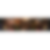
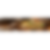
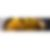
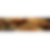
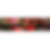
...
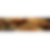
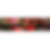
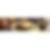
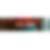
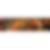

In [178]:
soup = BeautifulSoup(driver.page_source, "html.parser")
soup

In [179]:
links=[]
for i in soup.find_all('a'):
    if i.has_attr('href'):
        a= re.findall("^.*info$",i['href'])
        if len(a)==1:
            links.append(a[0])
links

['/hyderabad/barkaas-indo-arabic-restaurant-kukatpally/info',
 '/hyderabad/barkaas-indo-arabic-restaurant-kukatpally/info',
 '/hyderabad/tabla-kukatpally/info',
 '/hyderabad/tabla-kukatpally/info',
 '/hyderabad/brews-blends-kondapur/info',
 '/hyderabad/brews-blends-kondapur/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/pakka-local-kondapur/info',
 '/hyderabad/pakka-local-kondapur/info',
 '/hyderabad/komma-the-club-kothaguda/info',
 '/hyderabad/komma-the-club-kothaguda/info',
 '/hyderabad/mamagoto-kondapur/info',
 '/hyderabad/mamagoto-kondapur/info',
 '/hyderabad/barbeque-holic-kondapur/info',
 '/hyderabad/barbeque-holic-kondapur/info',
 '/hyderabad/air-live-gachibowli/info',
 '/hyderabad/air-live-gachibowli/info',
 '/hyderabad/firestone-grill-kukatpally/info',
 '/hyderabad/firestone-grill-kukatpally/info',
 '/hyderabad/chirp-gachibowli/info',
 '/hyderabad/chirp-gachibowli/info',
 '/hyderabad/krishnapatnam-kukatpally/info',
 '/hydera

In [180]:
links[::2]

['/hyderabad/barkaas-indo-arabic-restaurant-kukatpally/info',
 '/hyderabad/tabla-kukatpally/info',
 '/hyderabad/brews-blends-kondapur/info',
 '/hyderabad/exotica-hitech-city/info',
 '/hyderabad/pakka-local-kondapur/info',
 '/hyderabad/komma-the-club-kothaguda/info',
 '/hyderabad/mamagoto-kondapur/info',
 '/hyderabad/barbeque-holic-kondapur/info',
 '/hyderabad/air-live-gachibowli/info',
 '/hyderabad/firestone-grill-kukatpally/info',
 '/hyderabad/chirp-gachibowli/info',
 '/hyderabad/krishnapatnam-kukatpally/info',
 '/hyderabad/7-sisters-kondapur/info',
 '/hyderabad/heart-cup-coffee-kondapur/info',
 '/hyderabad/bbm-buffet-bar-music-gachibowli/info',
 '/hyderabad/dhaba-estd-1986-delhi-kondapur/info',
 '/hyderabad/cross-breed-club-kitchen-gachibowli/info',
 '/hyderabad/the-lal-street-bar-exchange-gachibowli/info',
 '/hyderabad/abs-absolute-barbecues-miyapur/info',
 '/hyderabad/animal-club-and-kitchen-gachibowli/info',
 '/hyderabad/punjab-grill-1-kondapur/info',
 '/hyderabad/china-bistro-kon

In [181]:
len(links[::2])

501

In [182]:
x = []
for i in links[::2]:
    x.append('https://www.zomato.com'+i)
x

['https://www.zomato.com/hyderabad/barkaas-indo-arabic-restaurant-kukatpally/info',
 'https://www.zomato.com/hyderabad/tabla-kukatpally/info',
 'https://www.zomato.com/hyderabad/brews-blends-kondapur/info',
 'https://www.zomato.com/hyderabad/exotica-hitech-city/info',
 'https://www.zomato.com/hyderabad/pakka-local-kondapur/info',
 'https://www.zomato.com/hyderabad/komma-the-club-kothaguda/info',
 'https://www.zomato.com/hyderabad/mamagoto-kondapur/info',
 'https://www.zomato.com/hyderabad/barbeque-holic-kondapur/info',
 'https://www.zomato.com/hyderabad/air-live-gachibowli/info',
 'https://www.zomato.com/hyderabad/firestone-grill-kukatpally/info',
 'https://www.zomato.com/hyderabad/chirp-gachibowli/info',
 'https://www.zomato.com/hyderabad/krishnapatnam-kukatpally/info',
 'https://www.zomato.com/hyderabad/7-sisters-kondapur/info',
 'https://www.zomato.com/hyderabad/heart-cup-coffee-kondapur/info',
 'https://www.zomato.com/hyderabad/bbm-buffet-bar-music-gachibowli/info',
 'https://www.z

In [183]:
name = []
cuisine = []
location = []
dining_rating = []
price = []
Takeaway = []
h_delivery = []
delivery_rating = []

for i in x:
    driver = webdriver.Chrome()
    driver.get(i)
    soup = BeautifulSoup(driver.page_source, "html.parser")
    content = soup.find_all('div', class_="sc-fEUNkw gAkuDn")
    
    for i in content:
        
        a = i.find("h1", class_="sc-7kepeu-0 sc-iSDuPN fwzNdh")
        if a:
            name.append(a.text)
        else:
            name.append(np.nan)
        
        b = i.find("div", class_="sc-fgfRvd gBMRZZ")
        if b:
            cuisine.append(b.text)
        else:
            cuisine.append(np.nan)
            
        c = i.find("a", class_="sc-clNaTc vNCcy")
        if c:
            location.append(c.text)
        else:
            location.append(np.nan)
        
        d = i.find("div", class_="sc-1q7bklc-1 cILgox")
        if d:
            dining_rating.append(d.text)
        else:
            dining_rating.append(np.nan)
        
        e = re.findall('₹(.*)\sfor\stwo\speople',i.text)
        if e:
            price.append(e[0])
        else:
            price.append(np.nan)
        
        f = re.findall('Takeaway\sAvailable',i.text)
        if f:
            Takeaway.append("Yes")
        else:
            Takeaway.append('No')
        
        g = re.findall('Home\sDelivery',i.text)
        if g:
            h_delivery.append("Yes")
        else:
            h_delivery.append('No')
            
        h = re.findall('Ratings(\d\.\d)star',i.text)
        if h:
            delivery_rating.append(h[0])
        else:
            delivery_rating.append(np.nan)

driver.quit()

In [184]:
df10 = pd.DataFrame({'Name' :  name, 
                'Cuisines':cuisine, 
                'Location':location, 
                'Dining_rating' :dining_rating,
                 'Price'  :price, 
                'Takeaway':Takeaway,
                'Home_Delivery':h_delivery,
                  'Delivery_rating':delivery_rating})
df10

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts","Kukatpally, Hyderabad",4.4,"1,300",Yes,Yes,3.9
1,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...","Kukatpally, Hyderabad",3.6,"1,250",Yes,Yes,4.2
2,Brews & Blends,"Continental, Italian, Pizza, Burger, Fast Food...","Kondapur, Hyderabad",4.5,"1,500",Yes,No,4.0
3,Exotica,"North Indian, Biryani, Kebab, Chinese, Orienta...","Hitech City, Hyderabad",4.8,"2,500",Yes,Yes,4.2
4,Pakka Local,"Andhra, Kebab, Chinese, North Indian, Biryani,...","Kondapur, Hyderabad",4.2,"1,200",Yes,Yes,3.9
...,...,...,...,...,...,...,...,...
468,Baitul Biryani,"Biryani, North Indian, Chinese, Mughlai, Kebab...","Kondapur, Hyderabad",-,300,Yes,Yes,3.9
469,Club 10 Chicken,"Fast Food, Pizza, Sandwich, Chinese, Street Fo...","Kukatpally, Hyderabad",-,350,Yes,Yes,3.6
470,Biryanis & Chopsticks,"Biryani, Chinese","Miyapur, Hyderabad",New,550,Yes,No,NaN
471,Nice Food Factory,"South Indian, Seafood, North Indian, Mughlai, ...","Chanda Nagar, Hyderabad",-,600,Yes,Yes,3.3


In [297]:
df = pd.concat([df1,df2,df3,df4,df5,df6,df7,df8,df9,df10])
df

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,NaN,NaN,NaN,NaN,NaN,No,No,NaN
1,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts","Kukatpally, Hyderabad",4.4,"1,300",Yes,Yes,3.9
2,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...","Kukatpally, Hyderabad",3.6,"1,250",Yes,Yes,4.2
3,Chowman,"Chinese, Thai, Asian, Seafood, Sichuan, Desser...","Kukatpally, Hyderabad",4.4,"1,400",Yes,Yes,4.2
4,Barbeque Holic,"Chinese, Salad, Fast Food, North Indian, Desse...","Kondapur, Hyderabad",4.5,"1,500",Yes,Yes,4.3
...,...,...,...,...,...,...,...,...
468,Baitul Biryani,"Biryani, North Indian, Chinese, Mughlai, Kebab...","Kondapur, Hyderabad",-,300,Yes,Yes,3.9
469,Club 10 Chicken,"Fast Food, Pizza, Sandwich, Chinese, Street Fo...","Kukatpally, Hyderabad",-,350,Yes,Yes,3.6
470,Biryanis & Chopsticks,"Biryani, Chinese","Miyapur, Hyderabad",New,550,Yes,No,NaN
471,Nice Food Factory,"South Indian, Seafood, North Indian, Mughlai, ...","Chanda Nagar, Hyderabad",-,600,Yes,Yes,3.3


In [298]:
df.reset_index(drop = True,inplace = True ) 
df

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,NaN,NaN,NaN,NaN,NaN,No,No,NaN
1,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts","Kukatpally, Hyderabad",4.4,"1,300",Yes,Yes,3.9
2,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...","Kukatpally, Hyderabad",3.6,"1,250",Yes,Yes,4.2
3,Chowman,"Chinese, Thai, Asian, Seafood, Sichuan, Desser...","Kukatpally, Hyderabad",4.4,"1,400",Yes,Yes,4.2
4,Barbeque Holic,"Chinese, Salad, Fast Food, North Indian, Desse...","Kondapur, Hyderabad",4.5,"1,500",Yes,Yes,4.3
...,...,...,...,...,...,...,...,...
4775,Baitul Biryani,"Biryani, North Indian, Chinese, Mughlai, Kebab...","Kondapur, Hyderabad",-,300,Yes,Yes,3.9
4776,Club 10 Chicken,"Fast Food, Pizza, Sandwich, Chinese, Street Fo...","Kukatpally, Hyderabad",-,350,Yes,Yes,3.6
4777,Biryanis & Chopsticks,"Biryani, Chinese","Miyapur, Hyderabad",New,550,Yes,No,NaN
4778,Nice Food Factory,"South Indian, Seafood, North Indian, Mughlai, ...","Chanda Nagar, Hyderabad",-,600,Yes,Yes,3.3


In [299]:
df.to_csv('zomato_test_2.csv')

# Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Reading CSV


In [2]:
df = pd.read_csv(r'/Users/pc/#/#ipynb/zomato_test_2.csv')
df

,Unnamed: 0,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,0,NaN,NaN,NaN,NaN,NaN,No,No,NaN
1,1,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts","Kukatpally, Hyderabad",4.4,"1,300",Yes,Yes,3.9
2,2,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...","Kukatpally, Hyderabad",3.6,"1,250",Yes,Yes,4.2
3,3,Chowman,"Chinese, Thai, Asian, Seafood, Sichuan, Desser...","Kukatpally, Hyderabad",4.4,"1,400",Yes,Yes,4.2
4,4,Barbeque Holic,"Chinese, Salad, Fast Food, North Indian, Desse...","Kondapur, Hyderabad",4.5,"1,500",Yes,Yes,4.3
...,...,...,...,...,...,...,...,...,...
4775,4775,Baitul Biryani,"Biryani, North Indian, Chinese, Mughlai, Kebab...","Kondapur, Hyderabad",-,300,Yes,Yes,3.9
4776,4776,Club 10 Chicken,"Fast Food, Pizza, Sandwich, Chinese, Street Fo...","Kukatpally, Hyderabad",-,350,Yes,Yes,3.6
4777,4777,Biryanis & Chopsticks,"Biryani, Chinese","Miyapur, Hyderabad",New,550,Yes,No,NaN
4778,4778,Nice Food Factory,"South Indian, Seafood, North Indian, Mughlai, ...","Chanda Nagar, Hyderabad",-,600,Yes,Yes,3.3


In [3]:
df.columns

Index(['Unnamed: 0', 'Name', 'Cuisines', 'Location', 'Dining_rating', 'Price',
       'Takeaway', 'Home_Delivery', 'Delivery_rating'],
      dtype='object')

# Dropping columns

In [4]:
df = df.drop(['Unnamed: 0'],axis=1)
df.head()

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,NaN,NaN,NaN,NaN,NaN,No,No,NaN
1,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts","Kukatpally, Hyderabad",4.4,"1,300",Yes,Yes,3.9
2,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...","Kukatpally, Hyderabad",3.6,"1,250",Yes,Yes,4.2
3,Chowman,"Chinese, Thai, Asian, Seafood, Sichuan, Desser...","Kukatpally, Hyderabad",4.4,"1,400",Yes,Yes,4.2
4,Barbeque Holic,"Chinese, Salad, Fast Food, North Indian, Desse...","Kondapur, Hyderabad",4.5,"1,500",Yes,Yes,4.3


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4780 entries, 0 to 4779
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             4322 non-null   object 
 1   Cuisines         4322 non-null   object 
 2   Location         4322 non-null   object 
 3   Dining_rating    4322 non-null   object 
 4   Price            4321 non-null   object 
 5   Takeaway         4780 non-null   object 
 6   Home_Delivery    4780 non-null   object 
 7   Delivery_rating  3327 non-null   float64
dtypes: float64(1), object(7)
memory usage: 298.9+ KB


## Dropping Duplicates

In [6]:
df.duplicated().sum()

2430

In [7]:
df[df.duplicated()]

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
5,NaN,NaN,NaN,NaN,NaN,No,No,NaN
7,NaN,NaN,NaN,NaN,NaN,No,No,NaN
9,NaN,NaN,NaN,NaN,NaN,No,No,NaN
14,NaN,NaN,NaN,NaN,NaN,No,No,NaN
23,NaN,NaN,NaN,NaN,NaN,No,No,NaN
...,...,...,...,...,...,...,...,...
4771,Scoops Ice Cream,"Ice Cream, Desserts, Pizza","Hafeezpet, Hyderabad",3.8,350,Yes,Yes,4.2
4772,Dostea,"Beverages, Street Food, Shake, Sandwich, Tea","Kondapur, Hyderabad",3.9,300,Yes,Yes,4.3
4774,Desi Pizzas,"Pizza, Sandwich, Fast Food, Beverages","Miyapur, Hyderabad",-,500,Yes,Yes,3.5
4777,Biryanis & Chopsticks,"Biryani, Chinese","Miyapur, Hyderabad",New,550,Yes,No,NaN


In [8]:
df.drop_duplicates(keep = 'first',inplace = True, ignore_index = True)
df

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,NaN,NaN,NaN,NaN,NaN,No,No,NaN
1,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts","Kukatpally, Hyderabad",4.4,"1,300",Yes,Yes,3.9
2,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...","Kukatpally, Hyderabad",3.6,"1,250",Yes,Yes,4.2
3,Chowman,"Chinese, Thai, Asian, Seafood, Sichuan, Desser...","Kukatpally, Hyderabad",4.4,"1,400",Yes,Yes,4.2
4,Barbeque Holic,"Chinese, Salad, Fast Food, North Indian, Desse...","Kondapur, Hyderabad",4.5,"1,500",Yes,Yes,4.3
...,...,...,...,...,...,...,...,...
2345,Little Island,"North Indian, Chinese, South Indian, Continent...","Swagath Grand, Hafeezpet, Hyderabad",3.7,850,Yes,No,NaN
2346,Sri Santosh Family Dhaba,"North Indian, Biryani, Chinese, South Indian, ...","Kondapur, Hyderabad",2.6,950,Yes,Yes,3.5
2347,Baitul Biryani,"Biryani, North Indian, Chinese, Mughlai, Kebab...","Kondapur, Hyderabad",-,300,Yes,Yes,3.9
2348,Club 10 Chicken,"Fast Food, Pizza, Sandwich, Chinese, Street Fo...","Kukatpally, Hyderabad",-,350,Yes,Yes,3.6


## Filling Null Values in Dining_Rating Column with zeroes

In [9]:
df['Dining_rating']

0       NaN
1       4.4
2       3.6
3       4.4
4       4.5
       ... 
2345    3.7
2346    2.6
2347      -
2348      -
2349      -
Name: Dining_rating, Length: 2350, dtype: object

In [10]:
# Removing 'New', '-' from Dining_rating column

def handlerate(value):
    if(value=='New' or value=='-'):
        return 0
    else:
        return float(value)
df['Dining_rating'] = df['Dining_rating'].apply(handlerate)
df['Dining_rating']

0       NaN
1       4.4
2       3.6
3       4.4
4       4.5
       ... 
2345    3.7
2346    2.6
2347    0.0
2348    0.0
2349    0.0
Name: Dining_rating, Length: 2350, dtype: float64

In [11]:
df.Dining_rating.isna().sum()

1

In [12]:
df[df['Name'].isna()]

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,NaN,NaN,NaN,NaN,NaN,No,No,NaN


In [13]:
df.dropna(thresh=3, ignore_index=True,inplace=True)  # Keep only the rows with at least 3 non-NA value

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2349 entries, 0 to 2348
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             2349 non-null   object 
 1   Cuisines         2349 non-null   object 
 2   Location         2349 non-null   object 
 3   Dining_rating    2349 non-null   float64
 4   Price            2348 non-null   object 
 5   Takeaway         2349 non-null   object 
 6   Home_Delivery    2349 non-null   object 
 7   Delivery_rating  1865 non-null   float64
dtypes: float64(2), object(6)
memory usage: 146.9+ KB


In [15]:
df.Dining_rating.isna().sum()

0

In [16]:
df.head()

,Name,Cuisines,Location,Dining_rating,Price,Takeaway,Home_Delivery,Delivery_rating
0,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts","Kukatpally, Hyderabad",4.4,"1,300",Yes,Yes,3.9
1,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...","Kukatpally, Hyderabad",3.6,"1,250",Yes,Yes,4.2
2,Chowman,"Chinese, Thai, Asian, Seafood, Sichuan, Desser...","Kukatpally, Hyderabad",4.4,"1,400",Yes,Yes,4.2
3,Barbeque Holic,"Chinese, Salad, Fast Food, North Indian, Desse...","Kondapur, Hyderabad",4.5,"1,500",Yes,Yes,4.3
4,7 Sisters,"North Eastern, Sushi, Tibetan","Kondapur, Hyderabad",4.6,"1,800",Yes,Yes,4.2


## Filling Null Values in Delivery_Rating Column with zeroes

In [17]:
df['Delivery_rating']

0       3.9
1       4.2
2       4.2
3       4.3
4       4.2
       ... 
2344    NaN
2345    3.5
2346    3.9
2347    3.6
2348    3.3
Name: Delivery_rating, Length: 2349, dtype: float64

In [18]:
import math

In [19]:
def handleNull(value):
    if math.isnan(value):       # Check for NaN using math.isnan()
        return 0                # Return numeric zero
    else:
        return float(value)

df['Delivery_rating'] = df['Delivery_rating'].apply(handleNull)
df['Delivery_rating'].unique()

array([3.9, 4.2, 4.3, 0. , 3.8, 4.5, 3.5, 3.7, 4. , 3.6, 4.4, 4.1, 3.3,
       3.4, 3.1, 3. , 2.3, 2.1, 2.2, 3.2, 4.6, 2.9, 2.7, 2.5, 2.6, 2.8])

In [20]:
df['Delivery_rating'].isna().sum()

0

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2349 entries, 0 to 2348
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             2349 non-null   object 
 1   Cuisines         2349 non-null   object 
 2   Location         2349 non-null   object 
 3   Dining_rating    2349 non-null   float64
 4   Price            2348 non-null   object 
 5   Takeaway         2349 non-null   object 
 6   Home_Delivery    2349 non-null   object 
 7   Delivery_rating  2349 non-null   float64
dtypes: float64(2), object(6)
memory usage: 146.9+ KB


In [22]:
df.rename(columns = {'Price':'Avg_cost(2)'}, inplace = True)
df

,Name,Cuisines,Location,Dining_rating,Avg_cost(2),Takeaway,Home_Delivery,Delivery_rating
0,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts","Kukatpally, Hyderabad",4.4,"1,300",Yes,Yes,3.9
1,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...","Kukatpally, Hyderabad",3.6,"1,250",Yes,Yes,4.2
2,Chowman,"Chinese, Thai, Asian, Seafood, Sichuan, Desser...","Kukatpally, Hyderabad",4.4,"1,400",Yes,Yes,4.2
3,Barbeque Holic,"Chinese, Salad, Fast Food, North Indian, Desse...","Kondapur, Hyderabad",4.5,"1,500",Yes,Yes,4.3
4,7 Sisters,"North Eastern, Sushi, Tibetan","Kondapur, Hyderabad",4.6,"1,800",Yes,Yes,4.2
...,...,...,...,...,...,...,...,...
2344,Little Island,"North Indian, Chinese, South Indian, Continent...","Swagath Grand, Hafeezpet, Hyderabad",3.7,850,Yes,No,0.0
2345,Sri Santosh Family Dhaba,"North Indian, Biryani, Chinese, South Indian, ...","Kondapur, Hyderabad",2.6,950,Yes,Yes,3.5
2346,Baitul Biryani,"Biryani, North Indian, Chinese, Mughlai, Kebab...","Kondapur, Hyderabad",0.0,300,Yes,Yes,3.9
2347,Club 10 Chicken,"Fast Food, Pizza, Sandwich, Chinese, Street Fo...","Kukatpally, Hyderabad",0.0,350,Yes,Yes,3.6


## Removing ',' from Avg_cost(2) column

In [23]:
df['Avg_cost(2)'].unique()  # I have got 2 values with different from other values

array(['1,300', '1,250', '1,400', '1,500', '1,800', '1,200', '2,500',
       '1,000', '400', '300', '3,000', '1,900', '700', '1,600', '950',
       '2,000', '550', '500', '850', '1,100', '200', '150', '600', '250',
       '800', '450', '350', '750', '900', '650', '100', '1,700', '3,500',
       '4,000', '2,400', '1,850', '2,200', '3,100', '5,000', '7,000', nan,
       '4,500', '4,200',
       '3,200 for two people (approx.)Exclusive of applicable taxes and charges, if any₹300 for a pint of beer (approx.)How do we calculate cost for two?Cash and Cards acceptedDigital payments acceptedMore InfoBreakfastHome DeliveryTakeaway AvailableValet Parking AvailableFamily FriendlyBuffetLive MusicBrunchIndoor SeatingLuxury DiningDesserts and Bakes4/5 StarOUR SPONSORSKavyam The Telugu Table4.3star-fillDINING3.7star-fillDELIVERYSouth Indian, North Indian, Biryani, Chinese, Kebab, Desserts, BeveragesSahib’s Barbeque By Ohri’s4.4star-fillDINING3.6star-fillDELIVERYNorth Indian, Awadhi, Hyderabadi, Desse

In [24]:
df['Avg_cost(2)'] = df['Avg_cost(2)'].replace('3,200 for two people (approx.)Exclusive of applicable taxes and charges, if any₹300 for a pint of beer (approx.)How do we calculate cost for two?Cash and Cards acceptedDigital payments acceptedMore InfoBreakfastHome DeliveryTakeaway AvailableValet Parking AvailableFamily FriendlyBuffetLive MusicBrunchIndoor SeatingLuxury DiningDesserts and Bakes4/5 StarOUR SPONSORSKavyam The Telugu Table4.3star-fillDINING3.7star-fillDELIVERYSouth Indian, North Indian, Biryani, Chinese, Kebab, Desserts, BeveragesSahib’s Barbeque By Ohri’s4.4star-fillDINING3.6star-fillDELIVERYNorth Indian, Awadhi, Hyderabadi, DessertsSunday Brunch12:30 pm - 03:00 pm₹2,100 + TAXWithout Alcohol Families with pets can enjoy brunch at alfresco seating area.Similar restaurantsThe Lounge Bar- ...4.5star-fillDINING-star-fillDELIVERYNorth Indian, Modern Indian, Finger Food, Chinese, BeveragesHyatt Hyderabad, Gachibowli, HyderabadCitrus Cafe - Le...4.1star-fillDINING-star-fillDELIVERYOriental, South Indian, North Indian, Chinese, Beverages, Salad, Street FoodLemon Tree Hotel, Gachibowli, HyderabadNoya - Avasa Hot...4.2star-fillDINING4.3star-fillDELIVERYModern Indian, North IndianHotel Avasa, Hitech City, HyderabadJewel of Nizam -...4.3star-fillDINING-star-fillDELIVERYHyderabadi, MughlaiThe Golkonda Resorts & Spa, Gandipet, HyderabadAre you a food blogger?Add a Zomato spoonback to your blog.right-triangleReview HighlightsSunday Brunch Sushi Pancakes Salads Deserts Sauce Classy Ambience Sophisticated Worth the Price Brunch Appetizers Breakfast Ganta Harika9 reviews0 FollowersFollow1star-fillDELIVERYone month agoThe quality of the food is too bad . They don’t deliver accordingly even after detailed and multiple instructions. Waste of time, money and energy. Never order here. Avoid the place too.0 Votes for helpful, 0 Commentsthumb-upHelpfulchatCommentshareShareN SK6 reviews0 FollowersFollow1star-fillDELIVERY5 months agoThey charged 700 for 100 Hm rice expected at least a portion size','3,200')

In [25]:
df['Avg_cost(2)'] = df['Avg_cost(2)'].replace('3,200 for two people (approx.)Exclusive of applicable taxes and charges, if any₹300 for a pint of beer (approx.)How do we calculate cost for two?Cash and Cards acceptedDigital payments acceptedMore InfoBreakfastHome DeliveryTakeaway AvailableValet Parking AvailableFamily FriendlyBuffetLive MusicBrunchIndoor SeatingLuxury DiningDesserts and Bakes4/5 StarOUR SPONSORSKavyam The Telugu Table4.3star-fillDINING3.7star-fillDELIVERYSouth Indian, North Indian, Biryani, Chinese, Kebab, Desserts, BeveragesCock & Bull4.8star-fillDINING3.5star-fillDELIVERYItalian, Mediterranean, British, Continental, Pizza, Waffle, Bar Food, BeveragesSunday Brunch12:30 pm - 03:00 pm₹2,100 + TAXWithout Alcohol Families with pets can enjoy brunch at alfresco seating area.Similar restaurantsThe Lounge Bar- ...4.5star-fillDINING-star-fillDELIVERYNorth Indian, Modern Indian, Finger Food, Chinese, BeveragesHyatt Hyderabad, Gachibowli, HyderabadCitrus Cafe - Le...4.1star-fillDINING-star-fillDELIVERYOriental, South Indian, North Indian, Chinese, Beverages, Salad, Street FoodLemon Tree Hotel, Gachibowli, HyderabadNoya - Avasa Hot...4.2star-fillDINING4.3star-fillDELIVERYModern Indian, North IndianHotel Avasa, Hitech City, HyderabadJewel of Nizam -...4.3star-fillDINING-star-fillDELIVERYHyderabadi, MughlaiThe Golkonda Resorts & Spa, Gandipet, HyderabadAre you a food blogger?Add a Zomato spoonback to your blog.right-triangleReview HighlightsSunday Brunch Sushi Pancakes Salads Deserts Sauce Classy Ambience Sophisticated Worth the Price Brunch Appetizers Breakfast Ganta Harika9 reviews0 FollowersFollow1star-fillDELIVERYone month agoThe quality of the food is too bad . They don’t deliver accordingly even after detailed and multiple instructions. Waste of time, money and energy. Never order here. Avoid the place too.0 Votes for helpful, 0 Commentsthumb-upHelpfulchatCommentshareShareN SK6 reviews0 FollowersFollow1star-fillDELIVERY5 months agoThey charged 700 for 100 Hm rice expected at least a portion size','3,200')

In [26]:
df['Avg_cost(2)'].unique()

array(['1,300', '1,250', '1,400', '1,500', '1,800', '1,200', '2,500',
       '1,000', '400', '300', '3,000', '1,900', '700', '1,600', '950',
       '2,000', '550', '500', '850', '1,100', '200', '150', '600', '250',
       '800', '450', '350', '750', '900', '650', '100', '1,700', '3,500',
       '4,000', '2,400', '1,850', '2,200', '3,100', '5,000', '7,000', nan,
       '4,500', '4,200', '3,200', '2,700', '1,150', '2,800', '3,800',
       '3,600'], dtype=object)

In [27]:
df[df['Avg_cost(2)'].isna()]

,Name,Cuisines,Location,Dining_rating,Avg_cost(2),Takeaway,Home_Delivery,Delivery_rating
712,Cafe Amlin,"Cafe, Continental, Italian, Fast Food, Beverag...","Banjara Hills, Hyderabad",0.0,NaN,No,No,0.0


In [28]:
df = df.drop(712)

In [29]:
df.reset_index(drop=True, inplace = True)

In [30]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2348 entries, 0 to 2347
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             2348 non-null   object 
 1   Cuisines         2348 non-null   object 
 2   Location         2348 non-null   object 
 3   Dining_rating    2348 non-null   float64
 4   Avg_cost(2)      2348 non-null   object 
 5   Takeaway         2348 non-null   object 
 6   Home_Delivery    2348 non-null   object 
 7   Delivery_rating  2348 non-null   float64
dtypes: float64(2), object(6)
memory usage: 146.9+ KB


In [31]:
def handlecomma(value):
    value = str(value)
    if ',' in value:
        value = value.replace(',','')
        return float(value)
    else:
        return float(value)
df['Avg_cost(2)'] = df['Avg_cost(2)'].apply(handlecomma)
df['Avg_cost(2)'].unique()

array([1300., 1250., 1400., 1500., 1800., 1200., 2500., 1000.,  400.,
        300., 3000., 1900.,  700., 1600.,  950., 2000.,  550.,  500.,
        850., 1100.,  200.,  150.,  600.,  250.,  800.,  450.,  350.,
        750.,  900.,  650.,  100., 1700., 3500., 4000., 2400., 1850.,
       2200., 3100., 5000., 7000., 4500., 4200., 3200., 2700., 1150.,
       2800., 3800., 3600.])

In [32]:
import re

In [33]:
a=[]
for i in df['Location']:
    j = re.findall("(.*)\,\sHyderabad",i)
    
    if len(j)==1:
        a.append(j[0])
    else:
        a.append(i)

In [34]:
df['location'] = a

In [35]:
for i in range(len(df['location'])):
    df['location'][i] = (re.sub('.*\,\s',"", df['location'][i]))

/var/folders/4m/pdc_fwqs1cdf0_lfztwt1fg80000gn/T/ipykernel_30524/2858238308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['location'][i] = (re.sub('.*\,\s',"", df['location'][i]))
/var/folders/4m/pdc_fwqs1cdf0_lfztwt1fg80000gn/T/ipykernel_30524/2858238308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['location'][i] = (re.sub('.*\,\s',"", df['location'][i]))
/var/folders/4m/pdc_fwqs1cdf0_lfztwt1fg80000gn/T/ipykernel_30524/2858238308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

In [36]:
df['location'].unique()

array(['Kukatpally', 'Kondapur', 'Madhapur', 'Moosapet', 'Hitech City',
       'Kothaguda', 'Nizampet', 'Miyapur', 'Moti Nagar', 'Jeedimetla',
       'Attapur ', 'Bachupally', 'Gachibowli', 'Jubilee Hills',
       'Chanda Nagar', 'Hafeezpet', 'Ofcourse', 'Balanagar', 'Suraram',
       'Film Nagar', 'Banjara Hills', 'The Skyview', 'Manikonda',
       'Ameerpet', 'Preston Prime Mall,Gachibowli', 'Panjagutta',
       'Srinagar Colony', 'Tolichowki', 'Hitech city', 'Sanath Nagar',
       'Holiday Inn Express & Suites', 'Begumpet', 'S R Nagar',
       'Mehdipatnam', 'Begumpet ', 'Financial District', 'Gandipet',
       'Madhpur', 'Necklace Road', 'Somajiguda', 'Masab Tank',
       'Khairatabad', 'Himayath Nagar', 'Attapur', 'Abids',
       'Basheer Bagh', 'Secunderabad', 'Nampally', 'Yousufguda',
       'Lakdikapul', 'Erragadda', 'Langer Houz', 'Charminar', 'Nagole',
       'Vanasthalipuram', 'Kothapet', 'L B Nagar', 'Dilsukhnagar',
       'Malakpet', 'Saroor Nagar', 'Meerpet', 'Mithila', '

In [37]:
df['location'].nunique()

71

In [38]:
df['Location'].nunique()

124

# Dropping Location column from the dataframe

In [39]:
df = df.drop(['Location'],axis=1)
df.head()

,Name,Cuisines,Dining_rating,Avg_cost(2),Takeaway,Home_Delivery,Delivery_rating,location
0,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts",4.4,1300.0,Yes,Yes,3.9,Kukatpally
1,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...",3.6,1250.0,Yes,Yes,4.2,Kukatpally
2,Chowman,"Chinese, Thai, Asian, Seafood, Sichuan, Desser...",4.4,1400.0,Yes,Yes,4.2,Kukatpally
3,Barbeque Holic,"Chinese, Salad, Fast Food, North Indian, Desse...",4.5,1500.0,Yes,Yes,4.3,Kondapur
4,7 Sisters,"North Eastern, Sushi, Tibetan",4.6,1800.0,Yes,Yes,4.2,Kondapur


# Cleaning the location column

In [40]:
location = df['location'].value_counts(ascending  = False)
location

location
Kukatpally                      273
Jubilee Hills                   172
Secunderabad                    161
Gachibowli                      153
Kondapur                        143
                               ... 
Langer Houz                       1
Attapur                           1
Ofcourse                          1
Holiday Inn Express & Suites      1
Mithila                           1
Name: count, Length: 71, dtype: int64

In [41]:
location_lessthan5 = location[location<5]
location_lessthan5

location
Hitech city                      4
Jeedimetla                       4
Srinagar Colony                  4
Necklace Road                    4
Yousufguda                       4
Gandipet                         4
Nampally                         3
Attapur                          3
Sanath Nagar                     2
Begumpet                         2
Medchal Road                     2
Madhpur                          2
Erragadda                        2
Preston Prime Mall,Gachibowli    2
The Skyview                      2
Suraram                          2
Charminar                        2
Balanagar                        2
Amberpet                         1
Langer Houz                      1
Attapur                          1
Ofcourse                         1
Holiday Inn Express & Suites     1
Mithila                          1
Name: count, dtype: int64

# Making location less than 5 in frequency as others

In [42]:
def handle_location(value):
    if(value in location_lessthan5):
        return 'others'
    else:
        return value
        
df['location'] = df['location'].apply(handle_location)
df['location'].value_counts()

location
Kukatpally            273
Jubilee Hills         172
Secunderabad          161
Gachibowli            153
Kondapur              143
Madhapur              118
Banjara Hills         106
Hitech City            91
Dilsukhnagar           91
Boduppal               86
L B Nagar              80
Vanasthalipuram        77
Kothapet               62
Habsiguda              58
Nagole                 57
Saroor Nagar           56
others                 56
Nizampet               53
Miyapur                41
Manikonda              35
Chanda Nagar           31
Meerpet                30
Kothaguda              26
Film Nagar             24
Begumpet               24
Ameerpet               21
Ramanthapur            19
Hafeezpet              17
Tolichowki             16
Moosapet               15
Himayath Nagar         11
Somajiguda             11
Tarnaka                11
Masab Tank             10
Malakpet               10
Moti Nagar             10
Medipally               9
Financial District      9
Lak

In [43]:
df['location'].unique()

array(['Kukatpally', 'Kondapur', 'Madhapur', 'Moosapet', 'Hitech City',
       'Kothaguda', 'Nizampet', 'Miyapur', 'Moti Nagar', 'others',
       'Bachupally', 'Gachibowli', 'Jubilee Hills', 'Chanda Nagar',
       'Hafeezpet', 'Film Nagar', 'Banjara Hills', 'Manikonda',
       'Ameerpet', 'Panjagutta', 'Tolichowki', 'Begumpet', 'S R Nagar',
       'Mehdipatnam', 'Financial District', 'Somajiguda', 'Masab Tank',
       'Khairatabad', 'Himayath Nagar', 'Abids', 'Basheer Bagh',
       'Secunderabad', 'Lakdikapul', 'Nagole', 'Vanasthalipuram',
       'Kothapet', 'L B Nagar', 'Dilsukhnagar', 'Malakpet',
       'Saroor Nagar', 'Meerpet', 'Ramanthapur', 'Boduppal', 'Habsiguda',
       'Tarnaka', 'Medipally', 'Narapally', 'Lingampally'], dtype=object)

# Data is Clean, Lets jump to Visual

## UNI - VARIATE ANALYSIS

In [44]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

Count Plot of Various Locations

In [45]:
df

,Name,Cuisines,Dining_rating,Avg_cost(2),Takeaway,Home_Delivery,Delivery_rating,location
0,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts",4.4,1300.0,Yes,Yes,3.9,Kukatpally
1,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...",3.6,1250.0,Yes,Yes,4.2,Kukatpally
2,Chowman,"Chinese, Thai, Asian, Seafood, Sichuan, Desser...",4.4,1400.0,Yes,Yes,4.2,Kukatpally
3,Barbeque Holic,"Chinese, Salad, Fast Food, North Indian, Desse...",4.5,1500.0,Yes,Yes,4.3,Kondapur
4,7 Sisters,"North Eastern, Sushi, Tibetan",4.6,1800.0,Yes,Yes,4.2,Kondapur
...,...,...,...,...,...,...,...,...
2343,Little Island,"North Indian, Chinese, South Indian, Continent...",3.7,850.0,Yes,No,0.0,Hafeezpet
2344,Sri Santosh Family Dhaba,"North Indian, Biryani, Chinese, South Indian, ...",2.6,950.0,Yes,Yes,3.5,Kondapur
2345,Baitul Biryani,"Biryani, North Indian, Chinese, Mughlai, Kebab...",0.0,300.0,Yes,Yes,3.9,Kondapur
2346,Club 10 Chicken,"Fast Food, Pizza, Sandwich, Chinese, Street Fo...",0.0,350.0,Yes,Yes,3.6,Kukatpally


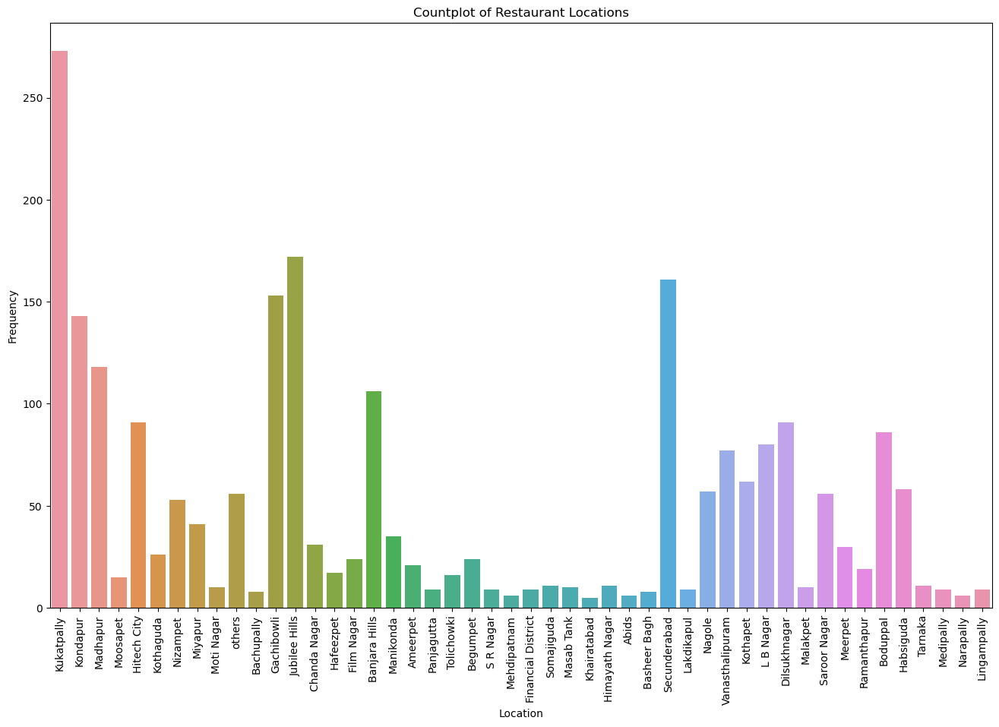

In [46]:
plt.figure(figsize = (16,10))
sns.countplot(data=df,x='location')
plt.title('Countplot of Restaurant Locations')
plt.xlabel('Location')
plt.ylabel('Frequency')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability if needed
plt.show()

* According to the Dataset, 
* Kukatpally has highest number of restaurants with around 270, followed by Jubilee Hills(170) and Secunderabad(160)
* Khairatabad has less number of restaurants with around 5
* There are more locations with less restaurants than locations with more restaurants
* There are 7 locations with more than 100 restaurants 

In [47]:
df['location'].value_counts()

location
Kukatpally            273
Jubilee Hills         172
Secunderabad          161
Gachibowli            153
Kondapur              143
Madhapur              118
Banjara Hills         106
Hitech City            91
Dilsukhnagar           91
Boduppal               86
L B Nagar              80
Vanasthalipuram        77
Kothapet               62
Habsiguda              58
Nagole                 57
Saroor Nagar           56
others                 56
Nizampet               53
Miyapur                41
Manikonda              35
Chanda Nagar           31
Meerpet                30
Kothaguda              26
Film Nagar             24
Begumpet               24
Ameerpet               21
Ramanthapur            19
Hafeezpet              17
Tolichowki             16
Moosapet               15
Himayath Nagar         11
Somajiguda             11
Tarnaka                11
Masab Tank             10
Malakpet               10
Moti Nagar             10
Medipally               9
Financial District      9
Lak

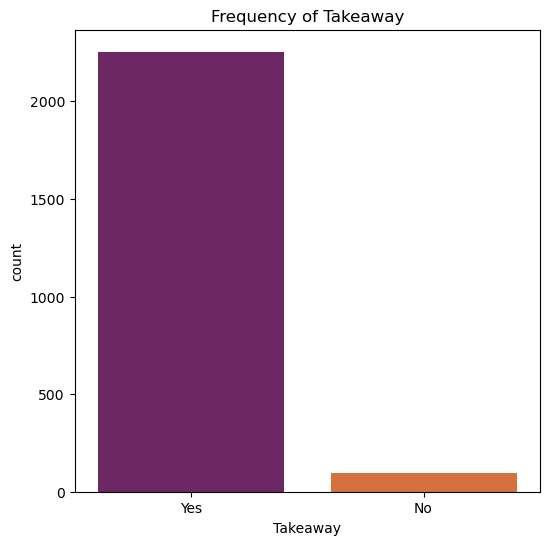

In [48]:
plt.figure(figsize = (6,6))
sns.countplot(data = df, x='Takeaway', palette = 'inferno')
plt.title('Frequency of Takeaway')
plt.show()

* Around 95% of restaurants has Takeaway facility 
* There are around 100 restaurants with no Takeaway facility

In [49]:
df['Takeaway'].value_counts()

Takeaway
Yes    2254
No       94
Name: count, dtype: int64

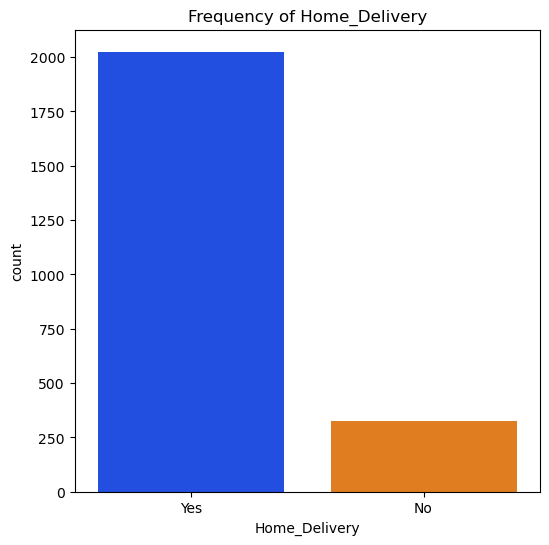

In [50]:
plt.figure(figsize = (6,6))
sns.countplot(data = df, x='Home_Delivery', palette = 'bright')
plt.title('Frequency of Home_Delivery')
plt.show()

* Around 90% of restaurants has Home Delivery service   
* Around 300 restaurants has no Home Delivery service

In [51]:
df['Home_Delivery'].value_counts()

Home_Delivery
Yes    2025
No      323
Name: count, dtype: int64

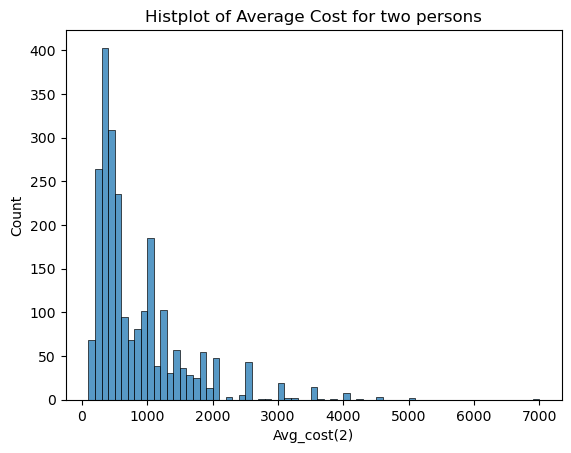

In [52]:
sns.histplot(data = df,x='Avg_cost(2)',binwidth = 100)
plt.title('Histplot of Average Cost for two persons')
plt.show()

* Around 400 Restaurants has 300 to 400 rupees as Average cost for 2 people 
* Average cost for 2 people is less than 1100 rupees in maximum restaurants
* There are very less restaurants with more than 4000 cost and No restaurants in between 5000 and 7000

In [227]:
df['Avg_cost(2)'].value_counts()

Avg_cost(2)
300.0     288
400.0     242
500.0     202
1000.0    185
200.0     147
250.0     117
350.0     115
1200.0     99
950.0      88
600.0      84
450.0      67
700.0      63
1400.0     57
850.0      51
2000.0     48
1800.0     44
2500.0     43
150.0      42
1100.0     37
1500.0     36
550.0      33
1300.0     31
800.0      30
1600.0     28
100.0      26
1700.0     25
3000.0     19
3500.0     14
1900.0     13
900.0      13
650.0      11
1850.0     10
4000.0      8
750.0       5
2400.0      5
1250.0      3
2200.0      3
4500.0      3
3100.0      2
5000.0      2
3200.0      2
7000.0      1
4200.0      1
2700.0      1
1150.0      1
2800.0      1
3800.0      1
3600.0      1
Name: count, dtype: int64

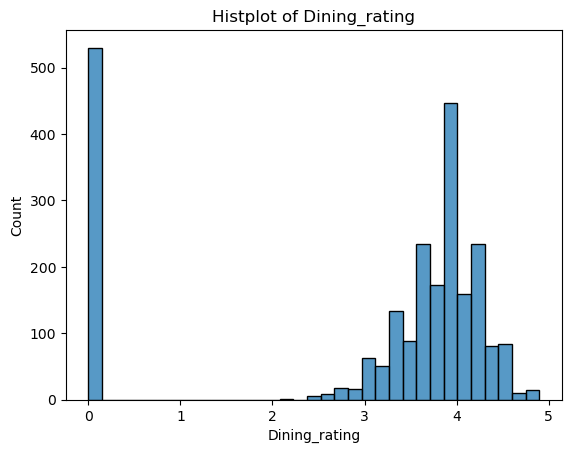

In [53]:
sns.histplot(data = df,x='Dining_rating')
plt.title('Histplot of Dining_rating')
plt.show()

* More than 500 Restaurants have Zero Dining_ratings becoz those are with no Dining_ratings at all.
* Between 3.0 to 4.5 ratings more Restaurants are present
* There are no Restaurants with rating between 0 to 2.

In [229]:
df['Dining_rating'].value_counts()

Dining_rating
0.0    530
3.9    282
3.8    173
4.0    165
4.1    159
3.7    132
4.2    130
4.3    105
3.6    103
3.5     88
4.4     81
3.3     69
3.4     64
4.5     56
3.2     50
3.1     37
4.6     27
3.0     25
2.9     16
2.8     11
4.7     10
2.6      8
4.8      8
2.7      6
4.9      6
2.5      3
2.4      3
2.1      1
Name: count, dtype: int64

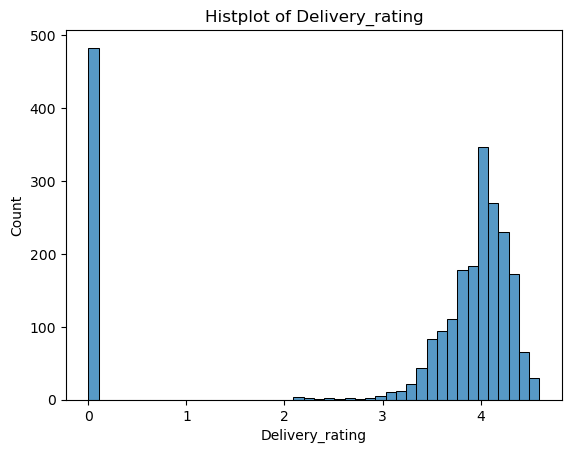

In [54]:
sns.histplot(data = df, x ='Delivery_rating')
plt.title('Histplot of Delivery_rating')
plt.show()

* Nearly 500 Restaurants has no Delivery_ratings, bcoz those are with Newly started and no delivery service.
* More Restaurants have delivery rating between 3.5 to 4.5

In [231]:
df['Delivery_rating'].value_counts()

Delivery_rating
0.0    483
4.0    346
4.1    270
4.2    230
3.9    183
3.8    178
4.3    172
3.7    110
3.6     94
3.5     83
4.4     65
3.4     43
4.5     22
3.3     21
3.2     12
3.1     10
4.6      7
3.0      5
2.1      3
2.2      2
2.9      2
2.7      2
2.5      2
2.3      1
2.6      1
2.8      1
Name: count, dtype: int64

# BIVARIATE ANALYSIS

In [232]:
df['Dining_Rating_Category']= np.nan

In [233]:
for i in range(len(df['Dining_rating'])):
    if df['Dining_rating'][i] >=4:
        df['Dining_Rating_Category'][i] = "High Rated"
    elif df['Dining_rating'][i] >=3 and df['Dining_rating'][i]<4:
        df['Dining_Rating_Category'][i] = "Medium Rated"
    else:
        df['Dining_Rating_Category'][i] = "Low Rated"

/var/folders/4m/pdc_fwqs1cdf0_lfztwt1fg80000gn/T/ipykernel_28271/1312414666.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Dining_Rating_Category'][i] = "High Rated"


In [234]:
df

,Name,Cuisines,Dining_rating,Avg_cost(2),Takeaway,Home_Delivery,Delivery_rating,location,Dining_Rating_Category
0,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts",4.4,1300.0,Yes,Yes,3.9,Kukatpally,High Rated
1,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...",3.6,1250.0,Yes,Yes,4.2,Kukatpally,Medium Rated
2,Chowman,"Chinese, Thai, Asian, Seafood, Sichuan, Desser...",4.4,1400.0,Yes,Yes,4.2,Kukatpally,High Rated
3,Barbeque Holic,"Chinese, Salad, Fast Food, North Indian, Desse...",4.5,1500.0,Yes,Yes,4.3,Kondapur,High Rated
4,7 Sisters,"North Eastern, Sushi, Tibetan",4.6,1800.0,Yes,Yes,4.2,Kondapur,High Rated
...,...,...,...,...,...,...,...,...,...
2343,Little Island,"North Indian, Chinese, South Indian, Continent...",3.7,850.0,Yes,No,0.0,Hafeezpet,Medium Rated
2344,Sri Santosh Family Dhaba,"North Indian, Biryani, Chinese, South Indian, ...",2.6,950.0,Yes,Yes,3.5,Kondapur,Low Rated
2345,Baitul Biryani,"Biryani, North Indian, Chinese, Mughlai, Kebab...",0.0,300.0,Yes,Yes,3.9,Kondapur,Low Rated
2346,Club 10 Chicken,"Fast Food, Pizza, Sandwich, Chinese, Street Fo...",0.0,350.0,Yes,Yes,3.6,Kukatpally,Low Rated


/Users/pc/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


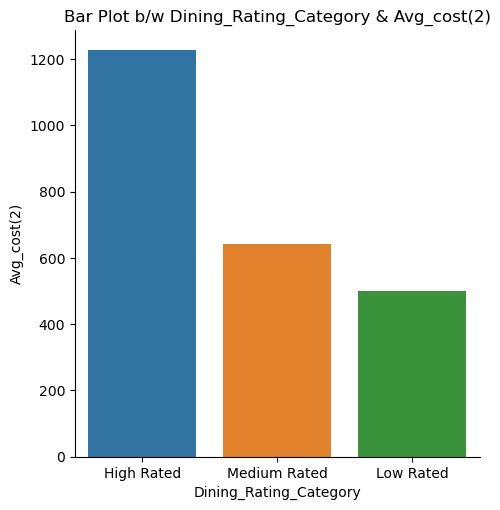

In [235]:
sns.catplot(data = df,x = 'Dining_Rating_Category',y = 'Avg_cost(2)',kind = 'bar',errorbar=None)
plt.title('Bar Plot b/w Dining_Rating_Category & Avg_cost(2)')
plt.show()

* The blue bar representing high-rated restaurants tend to be more expensive
* The orange bar representing medium-rated restaurans are less expensive than high-rated ones
* The red bar representing low-rated restaurants are the least expensive

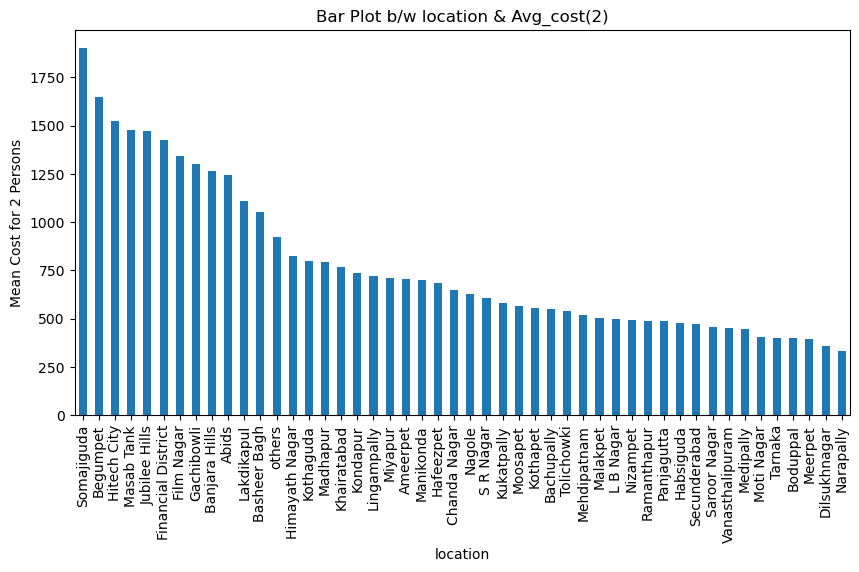

In [56]:
plt.figure(figsize=(10,5))
df.groupby('location')['Avg_cost(2)'].mean().sort_values(ascending=False).plot(kind='bar')
plt.title('Bar Plot b/w location & Avg_cost(2)')
plt.xlabel('location')
plt.ylabel('Mean Cost for 2 Persons')
plt.show()

* The most expensive location to eat for two people is Somajiguda, with mean cost of around 1800.
* The least expensive location to eat for two people is Narapally , with mean cost of around 300.
* The mean cost to eat for two people in most locations falls between 250 and 1000.


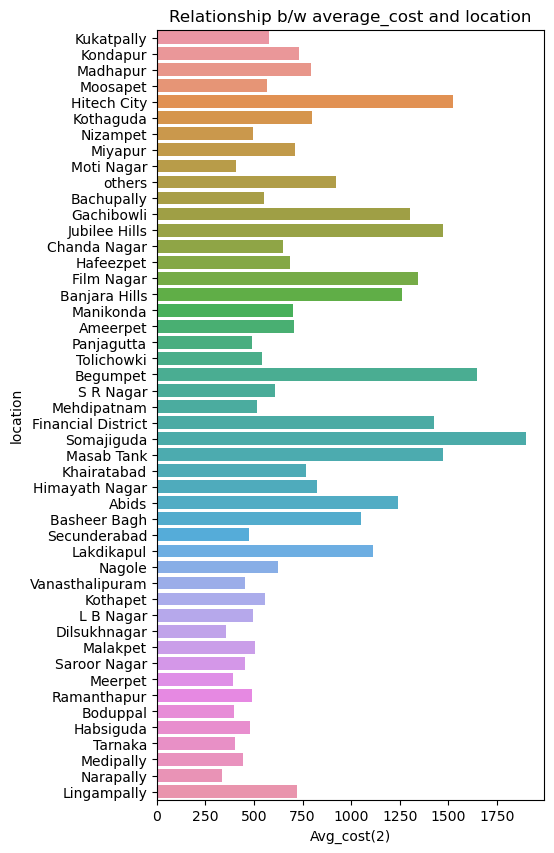

In [195]:
plt.figure(figsize=(5,10))
sns.barplot(data = df,x = 'Avg_cost(2)',y = 'location', errorbar=None)
plt.title('Relationship b/w average_cost and location')
plt.show()

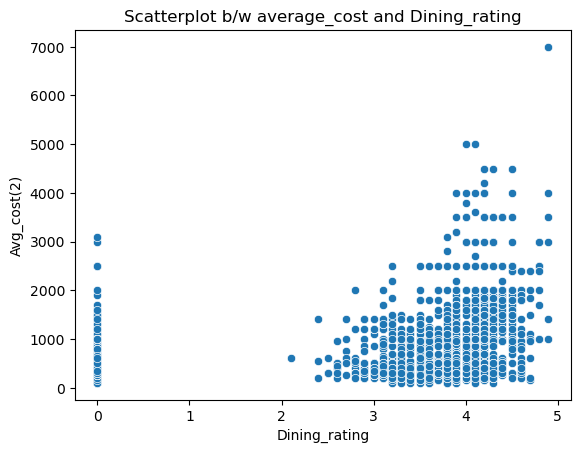

In [55]:
sns.scatterplot(data=df, x = 'Dining_rating',y = 'Avg_cost(2)')
plt.title('Scatterplot b/w average_cost and Dining_rating')
plt.show()

* For Dining_rating between 3.0 to 4.5 the average cost for 2 persons is around 300 to 2000.
* For 0 dining_rating restaurants the cost is increasing upto 3000
* For more cost, the dining_rating  is also more

In [246]:
pd.crosstab(columns=df['Home_Delivery'], index=df['location'])

Home_Delivery,No,Yes
location,,
Abids,1,5
Ameerpet,3,18
Bachupally,0,8
Banjara Hills,16,90
Basheer Bagh,1,7
Begumpet,4,20
Boduppal,12,74
Chanda Nagar,6,25
Dilsukhnagar,12,79


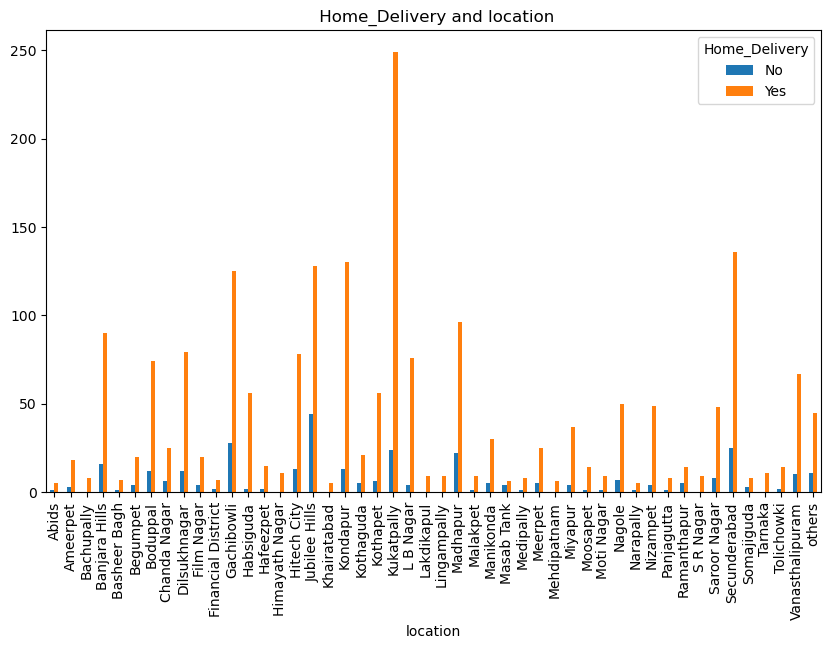

In [206]:
# Generate the crosstab
cross_tab = pd.crosstab(columns=df['Home_Delivery'], index=df['location'])

# Plotting with adjusted figure size
cross_tab.plot(kind='bar', figsize=(10, 6))  # Adjust width and height as needed
plt.title(' Home_Delivery and location')
# Show the plot
plt.show()


* The areas with the highest number of people ordering home delivery are Kukatpally, Secunderabad, Gachibowli, Jubilee Hills and Kondapur
* The areas with less number of people ordering home delivery are with less orange bars
* Jubilee Hills is the area with more No Home_Delivery 

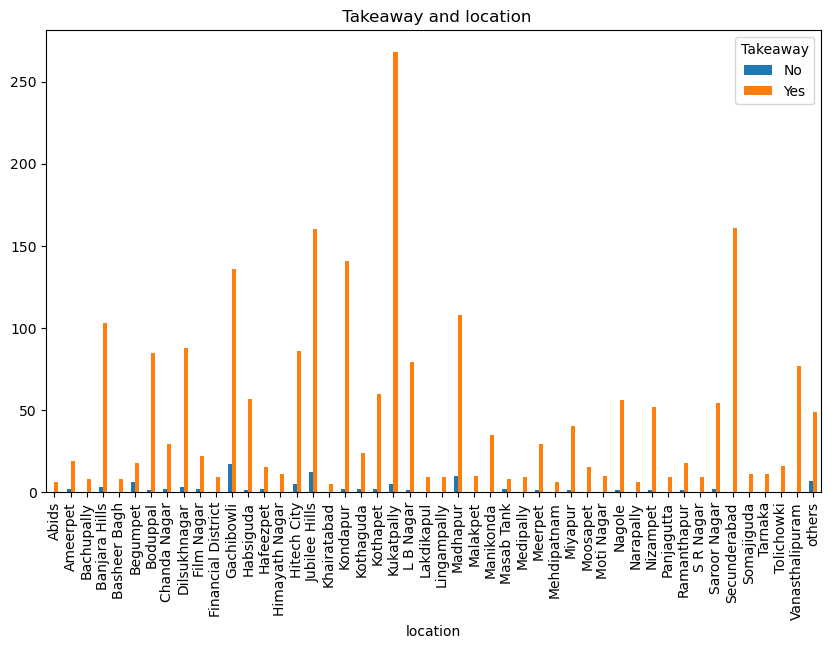

In [57]:
pd.crosstab(columns = df['Takeaway'],index = df['location']).plot(kind = 'bar', figsize=(10, 6))
plt.title(' Takeaway and location')
plt.show()


* The areas with the highest number of people taking Takeaways are Kukatpally, Jubilee Hills, Secunderabad, Gachibowli, and Kondapur
* Most of the areas are with less number ofTakeaways(Abids, Khairatabad & Mehdipatnam)
* Most locations prefer Takeaway.

In [248]:
pip install wordcloud

Note: you may need to restart the kernel to use updated packages.


In [249]:
df[df['Dining_rating']>4.5].groupby('Cuisines')['Cuisines'].count()

Cuisines
American, Mexican, Burger, Tex-Mex, Pasta, Desserts, Beverages                      1
Andhra, Chinese, North Indian, Biryani, South Indian, Desserts                      1
Asian, Continental, North Indian, Italian, Momos, Fast Food, Desserts, Beverages    1
BBQ, North Indian, Desserts                                                         1
Bakery                                                                              1
Bengali, North Indian, Seafood, Mughlai                                             1
Beverages, Fast Food, Shake, Waffle                                                 1
Burger, Fast Food                                                                   1
Cafe, Coffee, Continental, Italian, Pizza, Burger, Sandwich, Beverages              1
Cafe, Healthy Food, Burger, Pizza, Fast Food, Tea, Beverages, Bakery                1
Chinese, Asian, Sushi, Finger Food, Japanese, Thai, Ice Cream, Desserts             1
Chinese, Asian, Sushi, Japanese, Korean, Thai

In [250]:
text = df[df['Dining_rating']>4.5].groupby('Cuisines')['Cuisines'].count().to_string()
x = text.replace('\n',',').replace(' ','').replace('1','').replace('2','')

print(x)

Cuisines,American,Mexican,Burger,Tex-Mex,Pasta,Desserts,Beverages,Andhra,Chinese,NorthIndian,Biryani,SouthIndian,Desserts,Asian,Continental,NorthIndian,Italian,Momos,FastFood,Desserts,Beverages,BBQ,NorthIndian,Desserts,Bakery,Bengali,NorthIndian,Seafood,Mughlai,Beverages,FastFood,Shake,Waffle,Burger,FastFood,Cafe,Coffee,Continental,Italian,Pizza,Burger,Sandwich,Beverages,Cafe,HealthyFood,Burger,Pizza,FastFood,Tea,Beverages,Bakery,Chinese,Asian,Sushi,FingerFood,Japanese,Thai,IceCream,Desserts,Chinese,Asian,Sushi,Japanese,Korean,Thai,Seafood,Desserts,Chinese,Momos,FastFood,Sichuan,Chinese,Seafood,Desserts,Beverages,Asian,Chinese,Thai,Burmese,Vietnamese,Tibetan,Japanese,Continental,Chinese,Italian,FingerFood,Continental,Chinese,NorthIndian,Beverages,Desserts,Continental,Italian,Chinese,FastFood,Desserts,Continental,NorthIndian,Italian,Continental,Pizza,NorthIndian,Asian,Desserts,GrilledChicken,Pasta,Desserts,Beverages,Waffle,Pancake,FastFood,Shake,FastFood,Beverages,FastFood,Mexican,Steak

In [255]:
from wordcloud import WordCloud

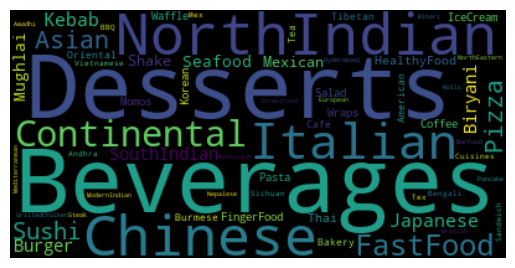

In [256]:
# Start with one review:
text = x

# Create and generate a word cloud image:
wordcloud = WordCloud().generate(text)

# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

* For Dining_rating > 4.5, the most famous Cuisines are Deserts, Beverages, North Indian, Chinese, Continental and Italian

In [257]:
df[df['Delivery_rating']>4.0].groupby('Cuisines')['Cuisines'].count()

Cuisines
Andhra, Biryani                                                                    2
Andhra, Biryani, Seafood                                                           1
Andhra, Biryani, South Indian, North Indian, Beverages                             1
Andhra, Chinese, Biryani, Desserts, Beverages                                      1
Andhra, Chinese, Kebab, North Indian, South Indian, Bar Food, Biryani, Desserts    1
                                                                                  ..
Tibetan, Momos, Chinese, Thai, Indonesian, Burmese, Sichuan                        1
Waffle                                                                             1
Waffle, Mexican, Pizza, Sandwich, Fast Food, Street Food, Desserts, Beverages      1
Waffle, Pancake, Desserts, Ice Cream, Beverages                                    1
Wraps, Burger, Sandwich, Fast Food, Mexican, Kebab                                 1
Name: Cuisines, Length: 554, dtype: int64

In [258]:
text = df[df['Delivery_rating']>4.0].groupby('Cuisines')['Cuisines'].count().to_string()
y = text.replace('\n',',').replace(' ','').replace('1','').replace('2','')

print(y)

Cuisines,Andhra,Biryani,Andhra,Biryani,Seafood,Andhra,Biryani,SouthIndian,NorthIndian,Beverages,Andhra,Chinese,Biryani,Desserts,Beverages,Andhra,Chinese,Kebab,NorthIndian,SouthIndian,BarFood,Biryani,Desserts,Andhra,Chinese,NorthIndian,Biryani,SouthIndian,Desserts,Andhra,Kebab,Chinese,NorthIndian,Biryani,Chettinad,Mughlai,Andhra,NorthIndian,Biryani,Chinese,Mughlai,Kebab,Desserts,Beverages,Andhra,NorthIndian,Biryani,Mughlai,Chinese,Desserts,Andhra,NorthIndian,Chinese,Biryani,Hyderabadi,Desserts,Andhra,NorthIndian,Chinese,Seafood,Desserts,Beverages,Andhra,NorthIndian,Kebab,FastFood,Seafood,Biryani,Chinese,Desserts,Andhra,SouthIndian,Biryani,NorthIndian,Chinese,Beverages,Desserts,Andhra,SouthIndian,Chinese,NorthIndian,Biryani,Desserts,Beverages,Arabian,Arabian,Biryani,Mughlai,Arabian,Kebab,Mandi,Arabian,Mandi,FastFood,Desserts,Beverages,Arabian,Mandi,Mughlai,Arabian,Wraps,FastFood,Asian,Continental,NorthIndian,Italian,Momos,FastFood,Desserts,Beverages,Asian,Japanese,Thai,Salad,Desserts,Asi

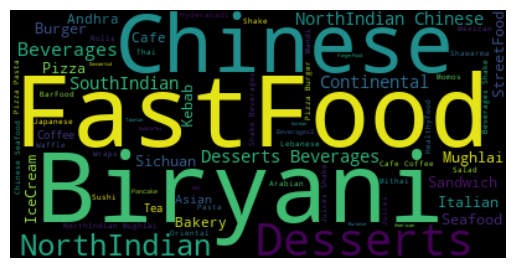

In [259]:
# Start with one review:
text = y

# Create and generate a word cloud image:
wordcloud = WordCloud().generate(text)

# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

* For Delivery_rating > 4.0, the most famous Cuisines are Chinese, FastFood, Biryani, Desserts & NorthIndian

In [260]:
k = ', '.join(df['Cuisines'])
k

'North Indian, Mandi, Biryani, Mughlai, Desserts, North Indian, Chinese, Andhra, Mughlai, Kebab, Biryani, South Indian, Desserts, Chinese, Thai, Asian, Seafood, Sichuan, Desserts, Beverages, Chinese, Salad, Fast Food, North Indian, Desserts, Beverages, North Eastern, Sushi, Tibetan, North Indian, Chinese, Mughlai, Biryani, Desserts, Beverages, South Indian, North Indian, Oriental, Italian, Fast Food, Desserts, South Indian, North Indian, Andhra, Desserts, Beverages, American, Burger, Italian, Beverages, Desserts, Pizza, Cafe, Continental, Pizza, Burger, Waffle, Tea, Pancake, Beverages, Mexican, Healthy Food, American, Salad, Fast Food, Beverages, Momos, Fast Food, Chinese, Tibetan, Sichuan, Beverages, Desserts, Continental, North Indian, Fast Food, Chinese, Desserts, Beverages, South Indian, North Indian, North Indian, Continental, Asian, Finger Food, Pizza, Biryani, Desserts, Beverages, Cafe, Pizza, Fast Food, Burger, Beverages, North Indian, Chinese, Continental, Biryani, Pasta, Pizz

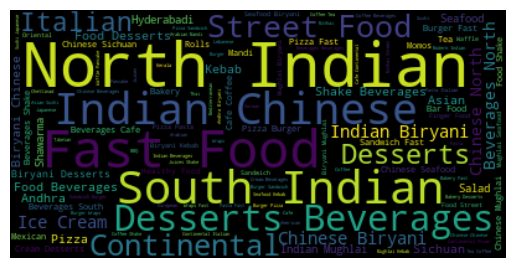

In [270]:
# Start with one review:
text = k

# Create and generate a word cloud image:
wordcloud = WordCloud().generate(text)

# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

* For Whole data, the most famous Cuisines are Chinese, Indian, FastFood, Beverages, Desserts, South Indian & North Indian

In [262]:
r =  ''
for i in df['Cuisines']:
    r+=i+', '

In [263]:
r

'North Indian, Mandi, Biryani, Mughlai, Desserts, North Indian, Chinese, Andhra, Mughlai, Kebab, Biryani, South Indian, Desserts, Chinese, Thai, Asian, Seafood, Sichuan, Desserts, Beverages, Chinese, Salad, Fast Food, North Indian, Desserts, Beverages, North Eastern, Sushi, Tibetan, North Indian, Chinese, Mughlai, Biryani, Desserts, Beverages, South Indian, North Indian, Oriental, Italian, Fast Food, Desserts, South Indian, North Indian, Andhra, Desserts, Beverages, American, Burger, Italian, Beverages, Desserts, Pizza, Cafe, Continental, Pizza, Burger, Waffle, Tea, Pancake, Beverages, Mexican, Healthy Food, American, Salad, Fast Food, Beverages, Momos, Fast Food, Chinese, Tibetan, Sichuan, Beverages, Desserts, Continental, North Indian, Fast Food, Chinese, Desserts, Beverages, South Indian, North Indian, North Indian, Continental, Asian, Finger Food, Pizza, Biryani, Desserts, Beverages, Cafe, Pizza, Fast Food, Burger, Beverages, North Indian, Chinese, Continental, Biryani, Pasta, Pizz

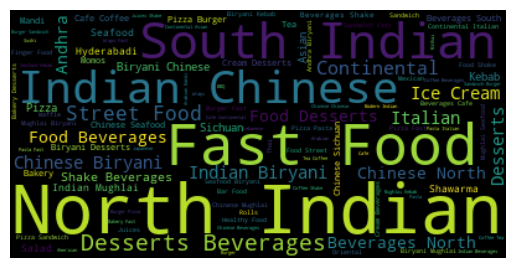

In [267]:
# Start with one review:
text = r

# Create and generate a word cloud image:
#wordcloud = WordCloud().generate(text)
wordcloud = WordCloud(max_font_size=200, max_words=100, background_color="Black").generate(text)
# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# MULTI-VARIATE ANALYSIS

## Heat Map

In [77]:
df.corr(numeric_only = True)

,Dining_rating,Avg_cost(2),Delivery_rating
Dining_rating,1.000000,0.308579,0.287400
Avg_cost(2),0.308579,1.000000,-0.183799
Delivery_rating,0.287400,-0.183799,1.000000


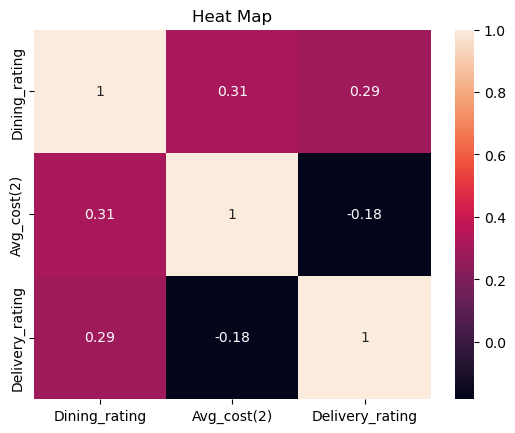

In [58]:
sns.heatmap(df.corr(numeric_only = True),annot=True)
plt.title('Heat Map')
plt.show()

* Weak positive correlation between dining rating and delivery rating(0.29) i.e directly proportional 
* Weak positive correlation between dining rating and average cost (0.31)    i.e directly proportional 
* Very weak negative correlation between delivery rating and average cost (-0.18) i.e inversely proportional 

## Pair Plot

/Users/pc/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


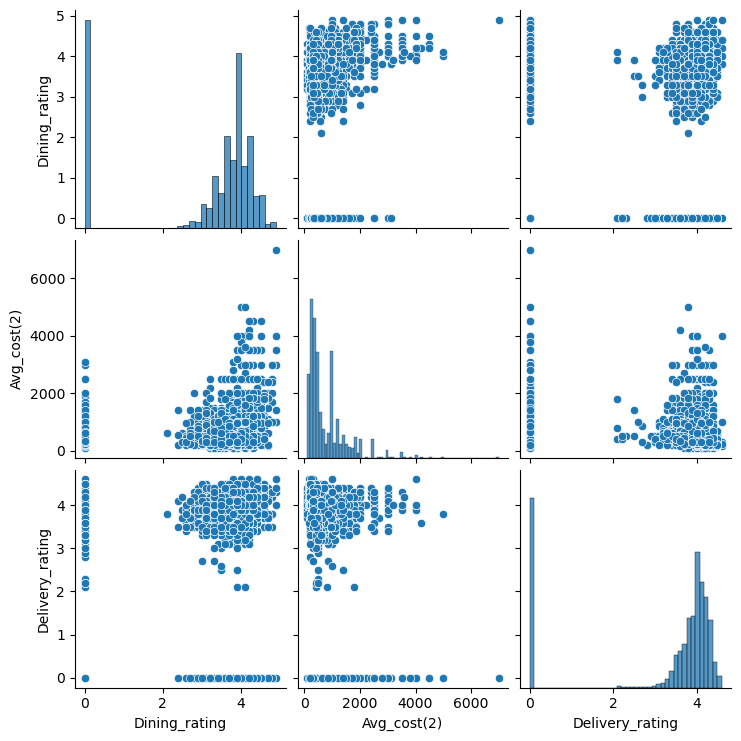

In [157]:
sns.pairplot(data=df)


* Restaurants with higher dining ratings tend to also have higher delivery ratings, but the correlation is not very strong
* Restaurants with higher dining ratings tend to also have higher average cost, but the correlation is not very strong
* Restaurants with higher delivery ratings tend to have lesser average cost, but the correlation is not very strong

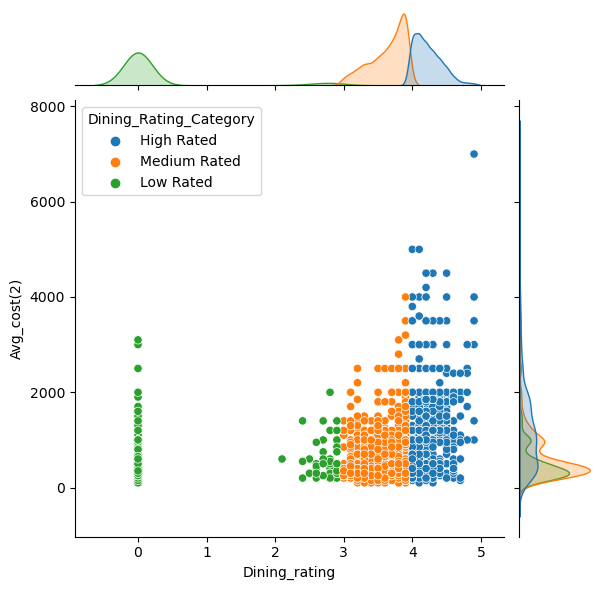

In [264]:
sns.jointplot(data =df,x = 'Dining_rating',y = 'Avg_cost(2)',hue = 'Dining_Rating_Category',palette = 'tab10')

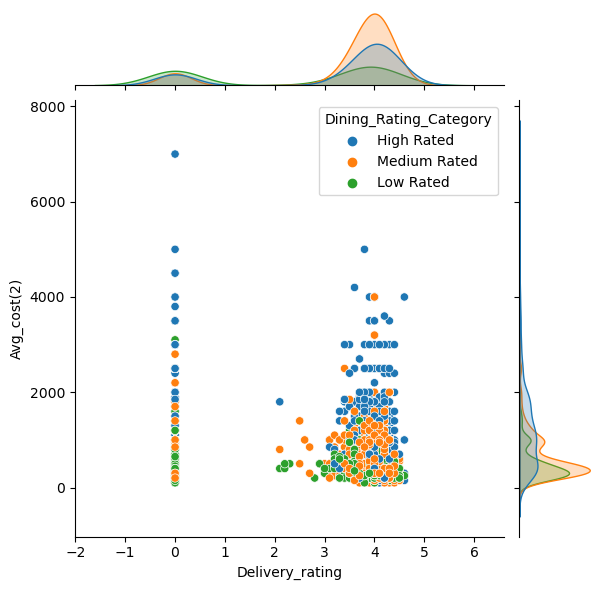

In [276]:
sns.jointplot(data =df,x = 'Delivery_rating',y = 'Avg_cost(2)',hue = 'Dining_Rating_Category',palette = 'tab10')

<Axes: xlabel='Delivery_rating', ylabel='Dining_rating'>

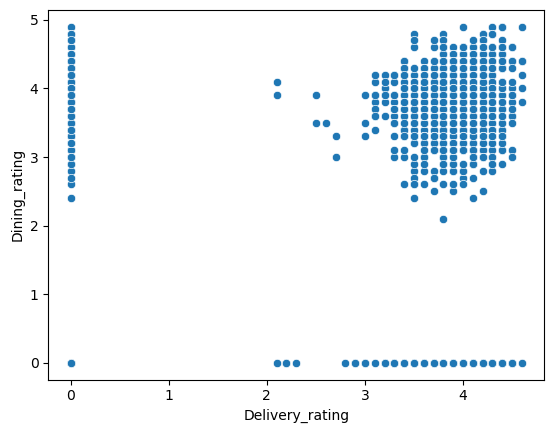

In [268]:
sns.scatterplot(data =df,x = 'Delivery_rating',y = 'Dining_rating')

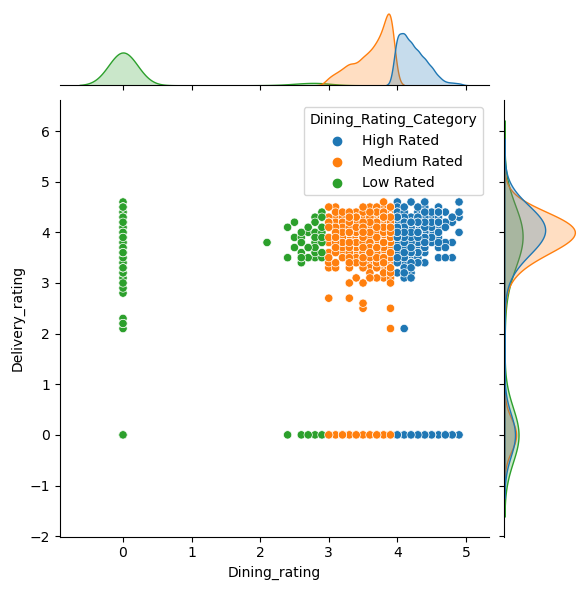

In [265]:
sns.jointplot(data =df,x = 'Dining_rating',y = 'Delivery_rating',hue = 'Dining_Rating_Category',palette = 'tab10')

In [159]:
df

,Name,Cuisines,Dining_rating,Avg_cost(2),Takeaway,Home_Delivery,Delivery_rating,location,Dining_Rating_Category
0,Barkaas Indo Arabic Restaurant,"North Indian, Mandi, Biryani, Mughlai, Desserts",4.4,1300.0,Yes,Yes,3.9,Kukatpally,High Rated
1,Tabla,"North Indian, Chinese, Andhra, Mughlai, Kebab,...",3.6,1250.0,Yes,Yes,4.2,Kukatpally,Medium Rated
2,Chowman,"Chinese, Thai, Asian, Seafood, Sichuan, Desser...",4.4,1400.0,Yes,Yes,4.2,Kukatpally,High Rated
3,Barbeque Holic,"Chinese, Salad, Fast Food, North Indian, Desse...",4.5,1500.0,Yes,Yes,4.3,Kondapur,High Rated
4,7 Sisters,"North Eastern, Sushi, Tibetan",4.6,1800.0,Yes,Yes,4.2,Kondapur,High Rated
...,...,...,...,...,...,...,...,...,...
2343,Little Island,"North Indian, Chinese, South Indian, Continent...",3.7,850.0,Yes,No,0.0,Hafeezpet,Medium Rated
2344,Sri Santosh Family Dhaba,"North Indian, Biryani, Chinese, South Indian, ...",2.6,950.0,Yes,Yes,3.5,Kondapur,Low Rated
2345,Baitul Biryani,"Biryani, North Indian, Chinese, Mughlai, Kebab...",0.0,300.0,Yes,Yes,3.9,Kondapur,Low Rated
2346,Club 10 Chicken,"Fast Food, Pizza, Sandwich, Chinese, Street Fo...",0.0,350.0,Yes,Yes,3.6,Kukatpally,Low Rated
